<h2><center> scRNAseq Pipeline: Clustering Human Pancreatic Islets Cell Types Based on Single-Cell Resolved Gene Expression Profile </center></h2>


### Table of Contents:
1. [Overview and Dataset](#1)  
   1.1. [Pipeline Diagram](#11)  
   1.2. [Motivation](#12)  
   1.3. [scRNA-seq Dataset](#13)
2. [Data Acquisition and Preprocessing](#2)  
   2.1. [scRNA-seq Raw Sequences Aligning and Quantification](#21)  
   2.2. [Importing Input: AnnData Object for scRNA-seq Count Matrix](#22)
3. [Data Cleaning and Transformation](#3)  
   3.1. [Quality Control Metrics and Visualization](#31)  
   3.2. [Normalization and Logarithmizing](#32)
4. [Feature Engineering, Dimensionality Reduction, and Systematic Correction](#4)  
   4.1. [Identifying Highly Variable Genes](#41)  
   4.2. [Principal Component Analysis](#42)  
   4.3. [Neighborhood Graph Construction](#43)  
   4.4. [Uniform Manifold Approximation and Projection](#44)  
   4.5. [Batch Correction](#45)
5. [Task Definition and Data Partitioning](#5)  
   5.1. [Task Definition](#51)  
   5.2. [Stratified Data Subsets](#52)
6. [Clustering Models Selection](#6)  
   6.1. [Louvain Model](#61)  
   6.2. [Leiden Model](#62)
7. [Running the Models, Hyperparameter Tuning, and Model Evaluations](#7)  
   7.1. [Tuning the Resolution Parameter](#71)  
   7.2. [Performance Metrics Evaluation and Comparison: Louvain Outperforms Slightly](#72)  
   7.3. [Evaluating Model's Robustness on Data Subsets](#73)
8. [Gene Markers and Cell Typing Analysis and Visualization](#8)  
   8.1. [Gene Markers Characterization in Clusters](#81)  
   8.2. [Clusters Cell Type Annotations](#82)
9. [Executive Summary](#9)
10. [References](#10)

### Updates Since the Last Pipeline:
I explored the Leiden model, which is an extension and improvement of the Louvain model that I used in the previous submission. I thoroughly explained Leiden and how it advances Louvain. I replicated the analysis I did on Louvain on Leiden, carefully compared their results, and accurately justified my choice. Additionally, I polished up the writing and formatting of the paper and added a pipeline diagram as a guide through the paper.

<a id='1'></a>
# 1. Overview and Dataset

<a id='11'></a>
## 1.1. Pipeline Diagram

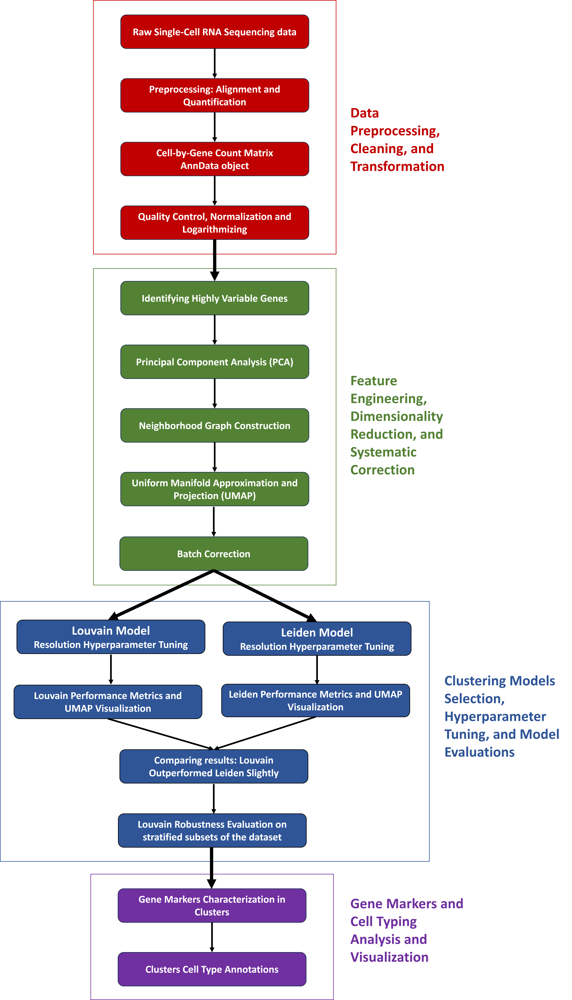

In [ ]:
from IPython.display import Image, display
display(Image(filename='./images/Pipeline Diagram.png', width=850, height=2300))

<a id='12'></a>
## 1.2. Motivation

<a id='13'></a>
## 1.3. scRNA-seq Dataset

The dataset I chose for this project is single-cell RNA sequencing (scRNA-seq) data for human pancreatic islets. I obtained the dataset from the National Institutes of Health's Gene Expression Omnibus (GEO), a database repository of high throughput gene expression data and hybridization arrays, chips, and microarrays. The dataset has the GEO accession ID of GSE198623. This dataset consists of high-quality single-cell RNA-seq (scRNA-seq) data for the pancreatic islets from healthy adult human donors and is collected and deposited by Tritschler et al. (2022). This dataset is a collection of 5 samples obtained from 5 different donors, named 22, 24, 61, 63, and 74.

Pancreatic islets, also called islets of Langerhans, are groups of cells in your pancreas. The pancreas is an organ that makes hormones to help your body break down and use food. Islets contain several types of cells, including beta cells that make the hormone insulin. Emerging evidence suggests that islet cells are functionally heterogeneous to allow a fine-tuned and efficient endocrine response to physiological changes. The recent yet rapid development in single-cell genomics technologies allowed us to analyze tissues and cell populations at single-cell resolution, which led to discovering new types of cells in different tissues and shed light on diverse mechanisms and interactions among them.

Single-cell RNA sequencing (scRNA-seq) comprises thousands of individual cells' produced RNA molecules, thus providing the gene expression profiles of these cells across thousands of genes. Since gene expression profile defines cell identity, scRNA-seq is considered the gold standard for defining cell states and phenotypes. This diagram represents a high-level overview of the scRNA-seq method:

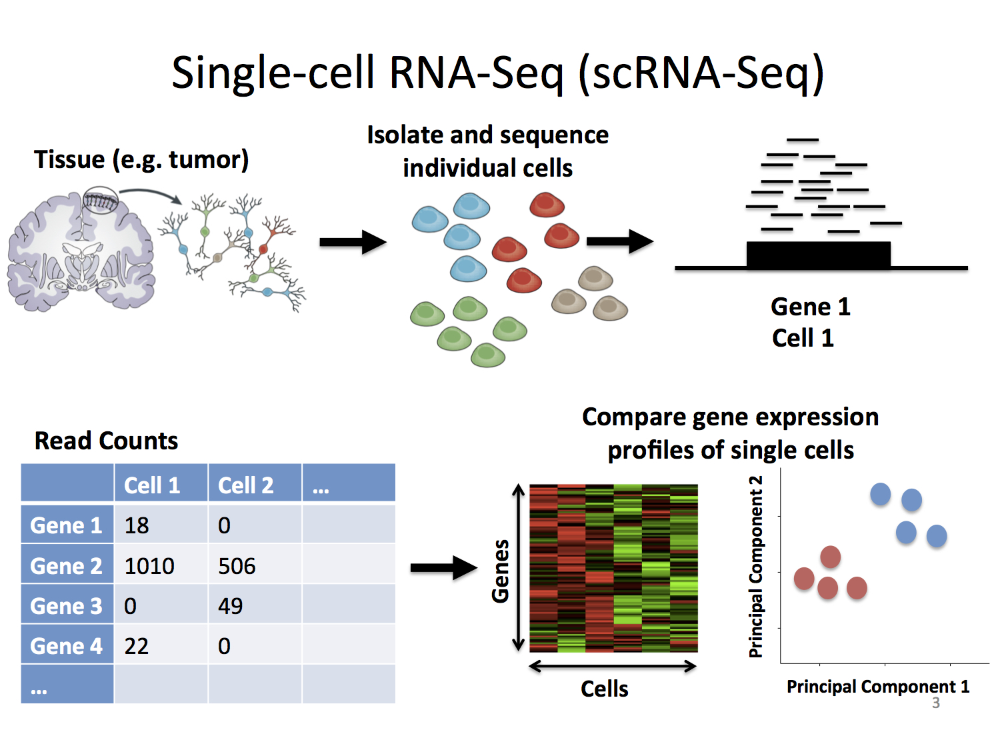

In [ ]:
display(Image(filename='./images/second pic.jpeg', width=600, height=300))

The overall goal of this project is to cluster the human pancreatic islet cells based on their gene expression profiles into different cell types and label their types based on marker genes using the given scRNA-seq data.

<a id='2'></a>
# 2. Data Acquisition and Preprocessing

<a id='21'></a>
## 2.1. scRNA-seq Raw Sequences Aligning and Quantification

Raw single-cell RNA-seq data comes in FastQ format, which contains sequences of nucleotides (A, C, G, T) representing the RNA transcripts present in each cell, along with quality scores for each nucleotide. This format is the primary output of high-throughput sequencing experiments. The journey from these raw reads to a usable count matrix, which is Python readable and used in the analysis below, involves several key steps, each critical to ensure the reliability and accuracy of the final data used for analysis.

Step 1: Quality Control. Initially, the FastQ files undergo quality control (QC) checks. This step involves assessing the quality of the raw sequencing data to identify and filter out low-quality reads, which might contain sequencing errors. Tools like FastQC are commonly used for this purpose, providing metrics on the quality of the reads, such as per base sequence quality, per sequence quality scores, and GC content.

Step 2: Alignment or Mapping. The next step is the alignment or mapping of reads to a reference genome or transcriptome. This process involves identifying the genomic or transcriptomic origin of each read. I used an alignment tool called STAR, which performs the QC, builds a reference genome, and aligns the sequences from the FastQ files to a reference, taking into account the possibility of splicing in RNA-seq data. The output of this step is typically in the form of BAM files, which list the genomic coordinates corresponding to each read.

Step 3: Transcript Quantification. Following alignment, transcript quantification is performed. This step involves counting the number of reads that map to each gene or transcript in the reference. The goal is to estimate the abundance of each transcript in each cell. Here, I used STAR as well for gene-level quantification, resulting in a raw count of reads for each gene per cell.

Step 4: Generation of the Count Matrix. The culmination of these steps is the generation of a count matrix. This matrix is a fundamental data structure in scRNA-seq analysis, where rows represent individual cells, columns represent genes, and each entry in the matrix corresponds to the number of reads (or counts) detected for a particular gene in a particular cell. This count matrix is readable by Python and can be used for clustering pipelines.

I performed the analysis above in the bash terminal on the server of my lab. The commented script I used is below:

\#Start


\#Make a directory for the pipeline

mkdir pipeline

cd pipeline

\#Get data

mkdir SRR_data

cd SRR_data

prefetch SRR18358809 --max-size 200G

cd ~/pipeline

\#Converting data to FASTQ

mkdir FASTQ_data

cd FASTQ_data

fasterq-dump ~/pipeline/SRR_data/sra/SRR18358809.sra --split-files

ls

cd ~/pipeline


\#Building the reference genome using STAR

mkdir reference_genome

cd reference_genome 

wget https://ftp.ensembl.org/pub/release-108/fasta/homo_sapiens/dna/Homo_sapiens.GRCh38.dna_sm.primary_assembly.fa.gz

wget https://ftp.ensembl.org/pub/release-108/gtf/homo_sapiens/Homo_sapiens.GRCh38.108.gtf.gz

gzip -d *.gz

cellranger mkgtf Homo_sapiens.GRCh38.108.gtf filtered_Homo_sapiens.GRCh38.108.gtf --attribute=gene_biotype:protein_coding

STAR --runMode genomeGenerate --runThreadN 4 --genomeDir STAR_annotated_index/ --genomeFastaFiles Homo_sapiens.GRCh38.dna_sm.primary_assembly.fa --sjdbGTFfile filtered_Homo_sapiens.GRCh38.108.gtf --genomeSAindexNbases 12 --genomeSAsparseD 3

cd ~/pipeline


\#Aligning, transcript quantification, and generating the count matrix using STAR

mkdir CB_whitelist

cd CB_whitelist

wget https://teichlab.github.io/scg_lib_structs/data/737K-august-2016.txt.gz

gzip -d *.gz

cd ~/pipeline

STAR --runThreadN 16   --genomeDir reference_genome/STAR_annotated_index/ --readFilesIn FASTQ_data/SRR18358809_2.fastq   FASTQ_data/SRR18358809_1.fastq  --outFileNamePrefix STARsolo_results/   --outReadsUnmapped Fastx   --outSAMattributes NH   HI   NM   MD  CB UB sM sS sQ    --outFilterMultimapNmax 1   --outFilterMatchNmin 30   --outFilterMismatchNmax 4   --alignIntronMax 1   --alignSJDBoverhangMin 999   --soloType CB_UMI_Simple --soloCellFilter EmptyDrops_CR  --soloCBwhitelist CB_whitelist/737K-august-2016.txt  --outSAMtype BAM SortedByCoordinate

samtools index ~/pipeline/STARsolo_results/Aligned.sortedByCoord.out.bam



\#End

<a id='22'></a>
## 2.2. Importing Input: AnnData Object for scRNA-seq Count Matrix

The output of this analysis is a cell-by-gene count matrix as an AnnData object in H5ad format. The H5ad format, a specialized HDF5-based format, is particularly suited for storing large-scale single-cell data due to its efficiency in handling high-dimensional data and compatibility with the Python ecosystem, especially with libraries like Scanpy which are tailored for single-cell analysis. The following diagram describes an AnnData object in H5ad format. The central part of the file (.X) is a sparse matrix that stores gene expression profiles for cells. The rows, observations (n_obs), are the cells, while the columns, variable (.n_vars), are the genes. The observations annotation (.obs) in the H5ad file provides key metadata for each cell, including sample identifiers, which are crucial for segregating and comparing cells from different samples. For example, the AnnData file I imported into Python below for the analysis contains the 5 samples (22, 24, 61, 63, and 74) stored in the observations annotation (.obs). The annotations of variables (.var) part include genes metadata. The embedding data part (.obsm) stores the analysis that will later be performed on the data, such as normalization, PCA, UMAP, clustering, and labeling. 

AnnData Object in H5ad Format:

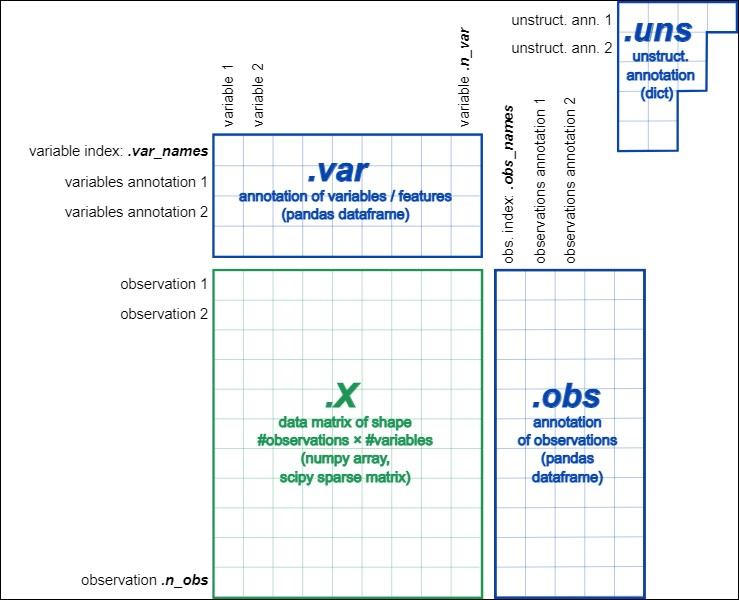

In [ ]:
display(Image(filename='./images/third pic.jpg', width=500, height=500))

In [ ]:
# Importing Libraries
import scanpy as sc
import anndata
import scipy as sp
import pandas as pd
import numpy as np
import seaborn as sb
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy.sparse import csr_matrix
from sklearn.model_selection import StratifiedShuffleSplit, train_test_split
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score

np.random.seed(223)

In [ ]:
# Reading the AnnData dataset into python as adata
file_path = './GSE198623_raw_data.h5ad'
adata = sc.read_h5ad(file_path)

In [ ]:
# Displaying the AnnData object describtion
adata

AnnData object with n_obs × n_vars = 33944 × 32738
    obs: 'sample'
    var: 'ensembl_ID'

In [ ]:
# Subset the data for each of the 5 samples based on the sample annotations in the data
unique_samples = adata.obs['sample'].unique()
sample_data = {}
for sample in unique_samples:
    sample_data[sample] = adata[adata.obs['sample'] == sample].copy()
    
adata22 = sample_data['22']
adata24 = sample_data['24']
adata61 = sample_data['61']
adata63 = sample_data['63']
adata74 = sample_data['74']

In [ ]:
# Displaying describtion for the subsets of AnnData object 
print(adata22)
print(adata24)
print(adata61)
print(adata63)
print(adata74)

AnnData object with n_obs × n_vars = 5476 × 32738
    obs: 'sample'
    var: 'ensembl_ID'
AnnData object with n_obs × n_vars = 6132 × 32738
    obs: 'sample'
    var: 'ensembl_ID'
AnnData object with n_obs × n_vars = 6427 × 32738
    obs: 'sample'
    var: 'ensembl_ID'
AnnData object with n_obs × n_vars = 5888 × 32738
    obs: 'sample'
    var: 'ensembl_ID'
AnnData object with n_obs × n_vars = 10021 × 32738
    obs: 'sample'
    var: 'ensembl_ID'


<a id='3'></a>
# 3. Data Cleaning and Transformation

In this section, I performed quality control, integrated the five datasets, and normalized and logarithmized the data.

<a id='31'></a>
## 3.1. Quality Control Metrics and Visualization

In this part of the analysis, I performed rigorous quality control (QC) measures on the scRNA-seq data. This crucial step ensures the reliability of subsequent analyses by identifying and excluding low-quality cells, which might otherwise skew results. Low-quality cells can be technical artifacts, dead cells, or duplicate cells. I wrote two functions, 'data_quality_control_check' and 'data_quality_control_apply', and applied them to each of the five samples in the dataset (22, 24, 61, 63, and 74).

The process begins with the 'data_quality_control_check' function, which serves two primary purposes:

1) Calculating QC Metrics: It computes key quality metrics for each cell, including the total number of RNA molecules (counts), the number of detected genes, and the percentage of reads corresponding to mitochondrial genes (indicative of cell stress or death). These metrics are crucial for assessing cell health and data quality.

2) Visualizing Data Quality: The function generates violin and scatter plots for these metrics, providing a visual assessment of data quality. For instance, plots of the total counts and number of genes help identify cells with unusually high or low transcript counts, which might represent doublets or empty droplets, respectively.

Following the QC checks, I applied the 'data_quality_control_apply' function. This function filters cells based on the QC metrics, using criteria such as minimum and maximum gene counts and mitochondrial gene percentages. This step is pivotal in removing cells that do not meet the defined quality standards, such as those with excessively high mitochondrial gene expression (a sign of cell stress or apoptosis) or abnormally high or low total RNA counts. By setting specific thresholds for these metrics, I ensured that only cells with reliable and representative data were retained for analysis.

The application of these functions to each sample results in a systematic and standardized approach to quality control across the dataset. The outcome is a refined dataset where each cell meets stringent quality criteria, laying a solid foundation for accurate and meaningful downstream analyses such as clustering and differential gene expression analysis. This process is instrumental in deriving reliable insights from the scRNA-seq data.

In [ ]:
def data_quality_control_check(adata):
    """
    Perform quality control (QC) analysis on an AnnData object used in scRNA-seq data analysis.

    This function calculates and adds QC metrics to the AnnData object for each cell. These metrics include 
    the total counts of RNA molecules per cell, the number of detected genes, and the fraction of 
    mitochondrial (MT) genes. It also generates violin plots and scatter plots for these metrics to assist 
    in determining appropriate threshold values for further quality control filtering.

    Parameters:
    -----------
    adata : AnnData
        An AnnData object containing scRNA-seq data. This object should have cells as rows and genes as columns.
    
    Returns:
    --------
    adata : AnnData
        The modified AnnData object with added QC metrics. The metrics added are 'n_genes_by_counts' (number of 
        genes detected in each cell), 'total_counts' (total number of RNA molecules detected per cell), and 
        'pct_counts_mt' (percentage of counts belonging to mitochondrial genes).

    Description:
    ------------
    The function identifies mitochondrial genes by checking if their names start with 'MT-'. It then calculates 
    the total RNA molecule counts, the number of genes detected, and the fraction of counts from mitochondrial 
    genes for each cell. 

    The function uses Scanpy's `calculate_qc_metrics` to compute these metrics and adds them to the AnnData 
    object. It also generates violin plots for the number of genes, total counts, and mitochondrial gene 
    percentage, as well as scatter plots to visualize the relationship between total counts and the number 
    of genes, and total counts versus mitochondrial gene percentage. These plots are essential for assessing 
    the quality of the data and deciding on thresholds for filtering out low-quality cells.
    """

    # Identify and annotate mitochondrial genes, which start with MT in their ID
    adata.var['mt'] = adata.var_names.str.startswith('MT-')

    # Calculate quality check metrics, particularly: total counts, no. of genes, and MT genes fraction
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=True, inplace=True)
    
    # Produce a violin plot for the quality check metrics 
    sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
    
    # Produce scatter plots for total count vs mitochondrial genes and gene count
    sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
    sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
    
    return adata

In [ ]:
def data_quality_control_apply(adata, min_counts, max_counts, min_genes, max_genes, max_pct_mt):
    
    """
    Apply a series of quality control filters to an AnnData object from scRNA-seq data.

    This function performs several filtering steps to remove low-quality cells based on specified 
    criteria: the maximum total counts, the minimum and maximum number of genes expressed, and the 
    maximum percentage of mitochondrial gene counts. The function prints the number of cells in the 
    dataset after each filtering step for tracking the impact of each criterion.

    Parameters:
    -----------
    adata : AnnData
        An AnnData object containing single-cell RNA sequencing data, with cells as rows and genes as columns.
    max_counts : int
        Maximum allowed total counts (sum of all gene expression counts) per cell. Cells exceeding this 
        threshold will be filtered out.
    min_genes : int
        Minimum number of genes that must be expressed in a cell. Cells with fewer expressed genes will 
        be filtered out.
    max_genes : int
        Maximum number of genes that must be expressed in a cell. Cells with more expressed genes will 
        be filtered out.
    max_pct_mt : float
        Maximum allowed percentage of mitochondrial gene counts. Cells with a higher percentage will be 
        filtered out.

    Returns:
    --------
    AnnData
        The filtered AnnData object.

    Description:
    ------------
    The function begins by filtering genes that are detected in at least a minimum number of cells.
    It then applies a series of cell-level filters based on total counts, number of genes expressed, 
    and mitochondrial gene expression. These filters help in identifying and removing potential outliers 
    or cells with poor-quality data, such as dying cells (often indicated by high mitochondrial content) 
    or empty droplets.

    """
    
    # Number of cells before any filtering
    print('Total number of cells before filtering: {:d}'.format(adata.n_obs))
    
    # Filter out counts over min_counts
    sc.pp.filter_cells(adata, min_counts = min_counts)
    print('Number of cells after min count filter: {:d}'.format(adata.n_obs))
    
    # Filter out counts over max_counts
    sc.pp.filter_cells(adata, max_counts = max_counts)
    print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

    # Filter out cells with under min_genes genes
    sc.pp.filter_cells(adata, min_genes = min_genes)
    print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

    #Filter out cells with over max_genes genes
    sc.pp.filter_cells(adata, max_genes = max_genes)
    print('Number of cells after gene filter: {:d}'.format(adata.n_obs))
    
    # Filter out cells with high percentage of mitochondrial genes
    #adata = adata[adata.obs.pct_counts_mt < max_pct_mt, :].copy()
    adata = adata[adata.obs['pct_counts_mt'] < max_pct_mt].copy()

    print('Number of cells after MT pct filter: {:d}'.format(adata.n_obs))
    
    return adata

#### Sample 22

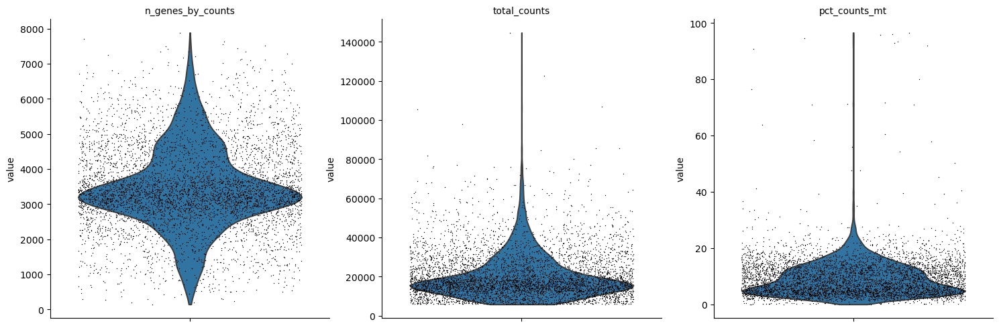

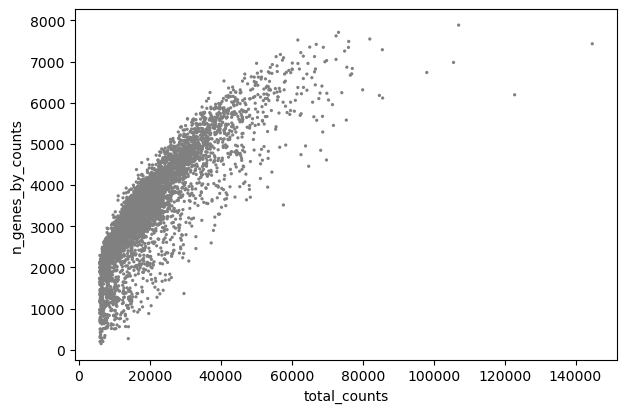

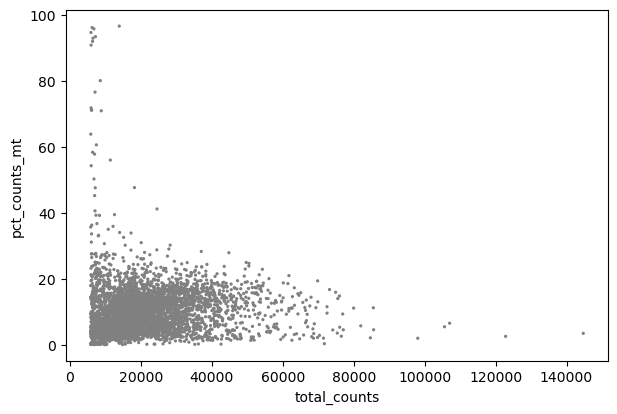

AnnData object with n_obs × n_vars = 5476 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics
data_quality_control_check(adata22)

In [ ]:
# Apply selected QC values
adata22 = data_quality_control_apply(adata22, min_counts=200, max_counts=40000, min_genes=1600, max_genes=6500, max_pct_mt=20)
adata22

Total number of cells before filtering: 5476
Number of cells after min count filter: 5476
Number of cells after max count filter: 5115
Number of cells after gene filter: 4806
Number of cells after gene filter: 4806
Number of cells after MT pct filter: 4661


AnnData object with n_obs × n_vars = 4661 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

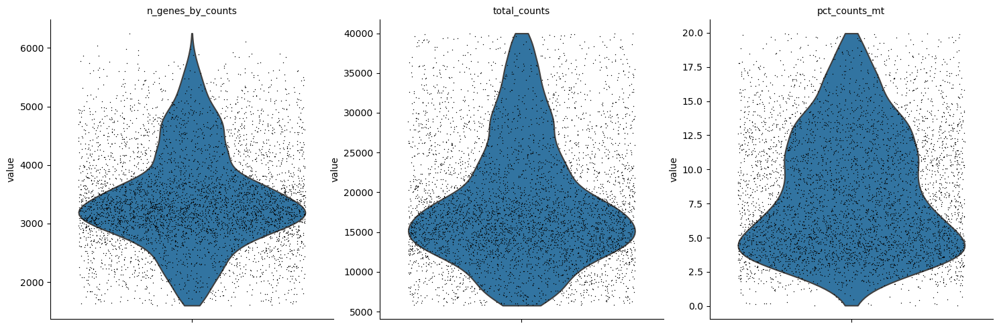

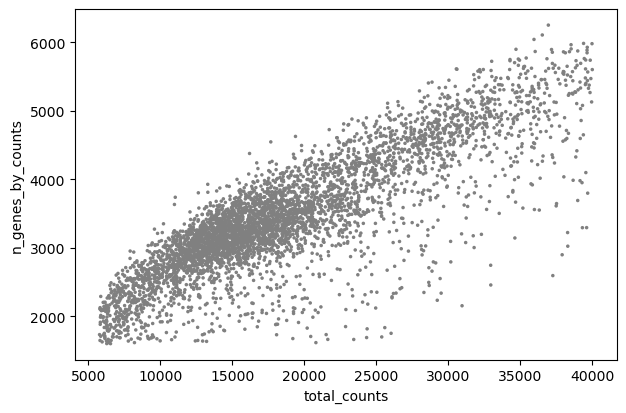

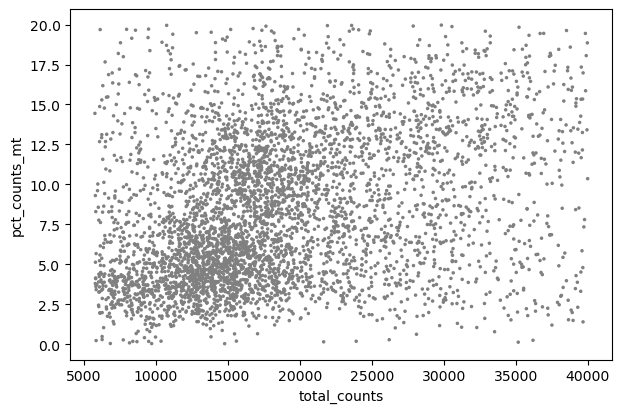

AnnData object with n_obs × n_vars = 4661 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics after applying QC
data_quality_control_check(adata22)

#### Sample 24

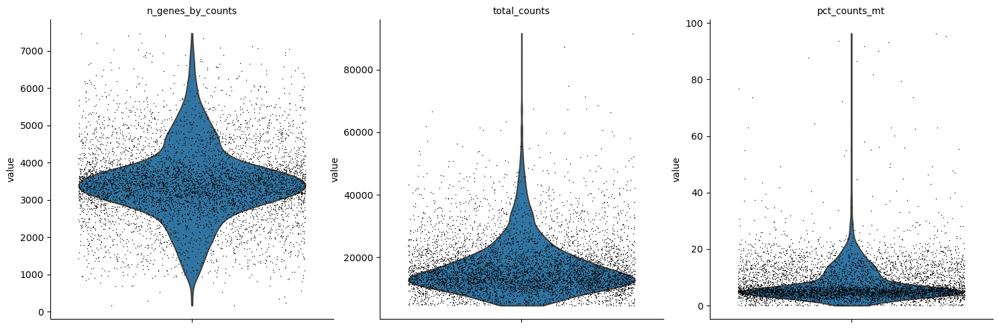

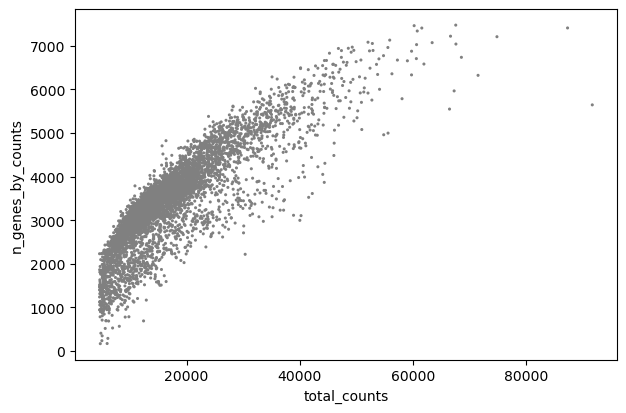

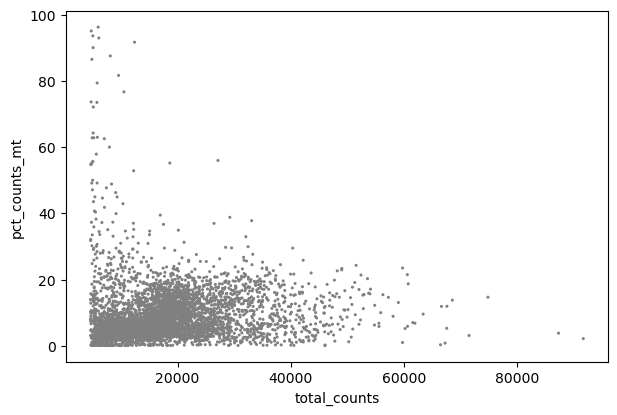

AnnData object with n_obs × n_vars = 6132 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics
data_quality_control_check(adata24)

In [ ]:
# Apply selected QC values
adata24 = data_quality_control_apply(adata24, min_counts=200, max_counts=50000, min_genes=1000, max_genes=6500, max_pct_mt=20)
adata24

Total number of cells before filtering: 6132
Number of cells after min count filter: 6132
Number of cells after max count filter: 6083
Number of cells after gene filter: 6034
Number of cells after gene filter: 6015
Number of cells after MT pct filter: 5769


AnnData object with n_obs × n_vars = 5769 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

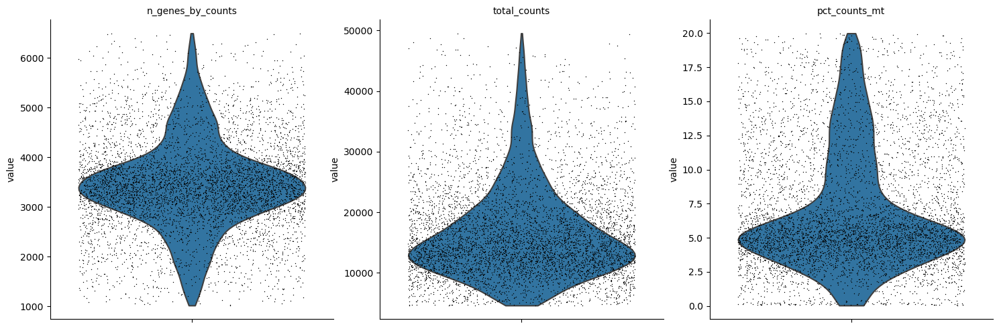

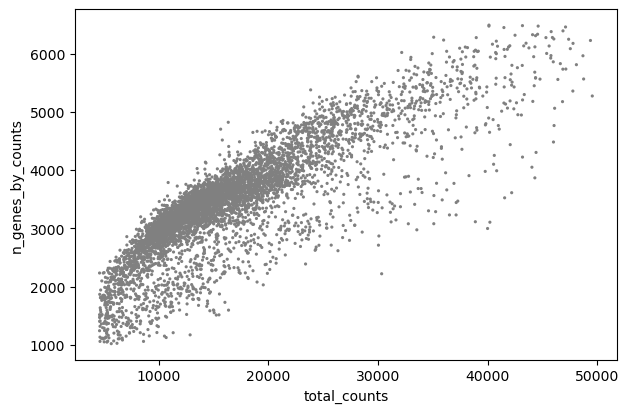

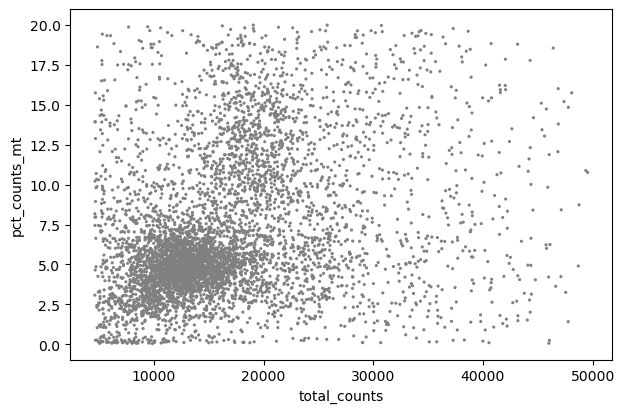

AnnData object with n_obs × n_vars = 5769 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics after applying QC
data_quality_control_check(adata24)

#### Sample 61

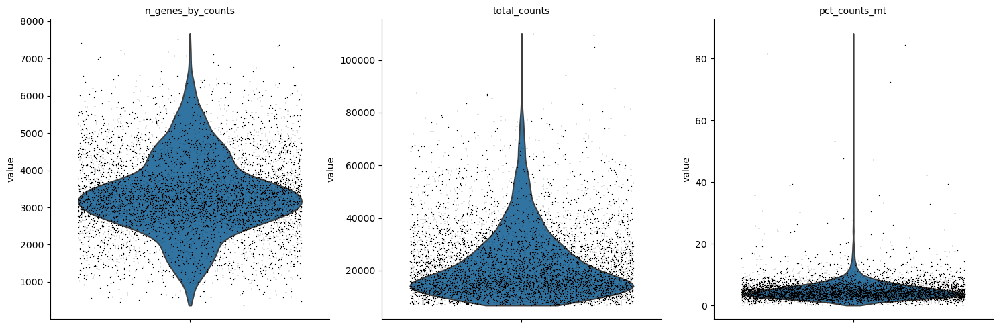

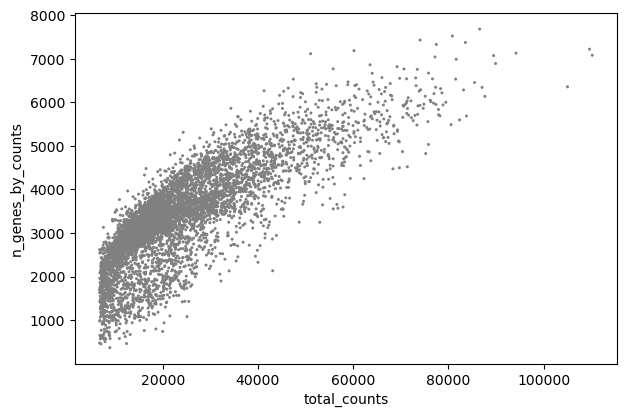

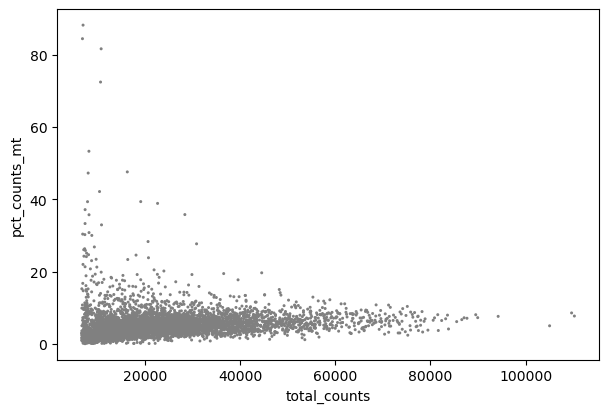

AnnData object with n_obs × n_vars = 6427 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics
data_quality_control_check(adata61)

In [ ]:
# Apply selected QC values
adata61 = data_quality_control_apply(adata61, min_counts=200, max_counts=60000, min_genes=1000, max_genes=6500, max_pct_mt=20)
adata61

Total number of cells before filtering: 6427
Number of cells after min count filter: 6427
Number of cells after max count filter: 6267
Number of cells after gene filter: 6203
Number of cells after gene filter: 6200
Number of cells after MT pct filter: 6164


AnnData object with n_obs × n_vars = 6164 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

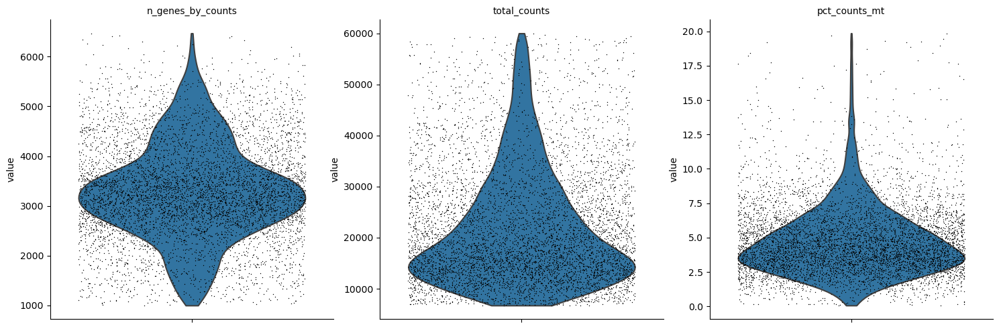

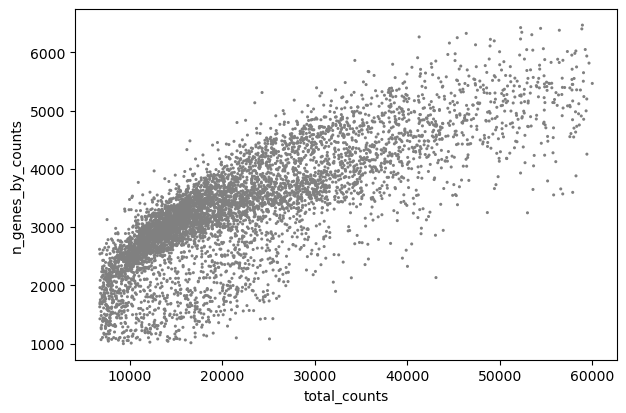

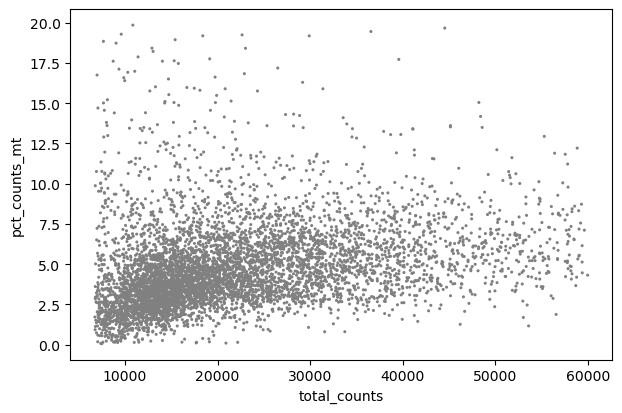

AnnData object with n_obs × n_vars = 6164 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics after applying QC
data_quality_control_check(adata61)

#### Sample 63

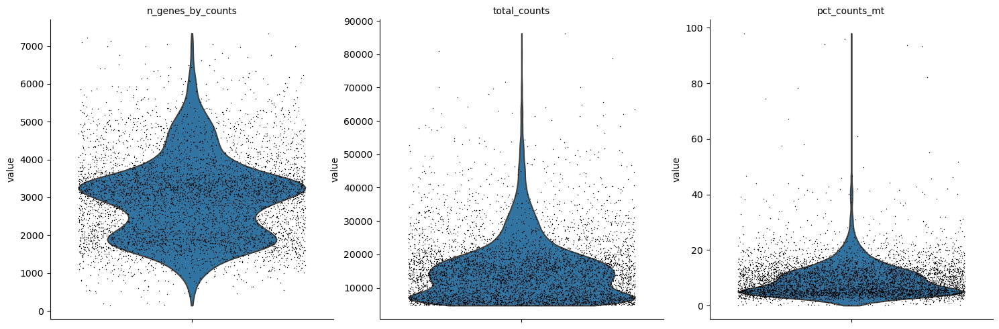

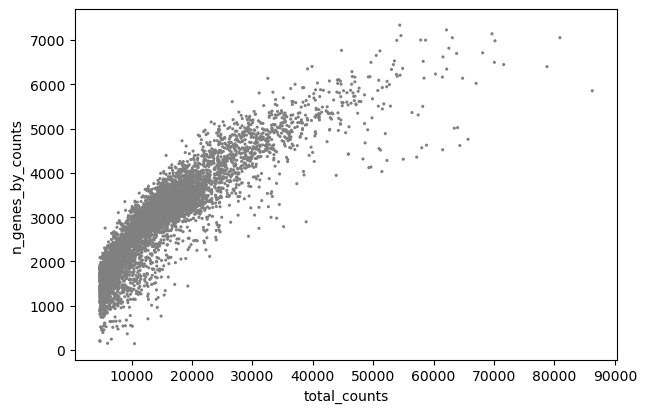

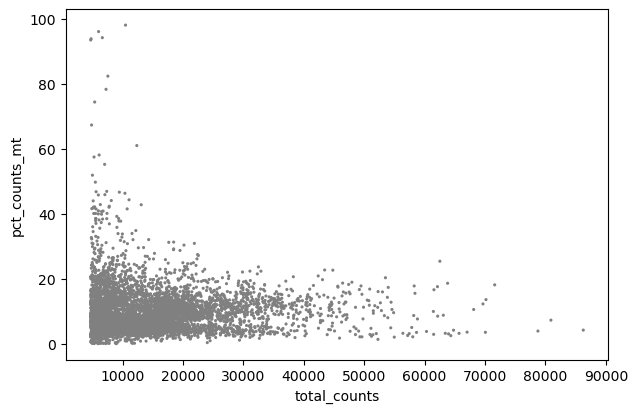

AnnData object with n_obs × n_vars = 5888 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics
data_quality_control_check(adata63)

In [ ]:
# Apply selected QC values
adata63 = data_quality_control_apply(adata63, min_counts=200, max_counts=55000, min_genes=900, max_genes=6500, max_pct_mt=20)
adata63

Total number of cells before filtering: 5888
Number of cells after min count filter: 5888
Number of cells after max count filter: 5855
Number of cells after gene filter: 5798
Number of cells after gene filter: 5791
Number of cells after MT pct filter: 5507


AnnData object with n_obs × n_vars = 5507 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

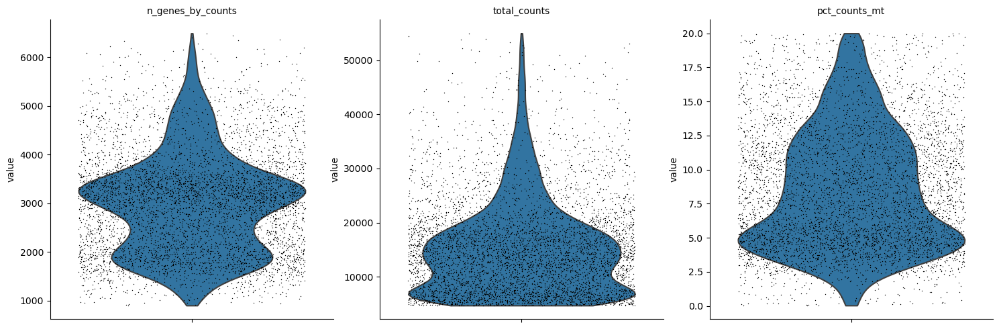

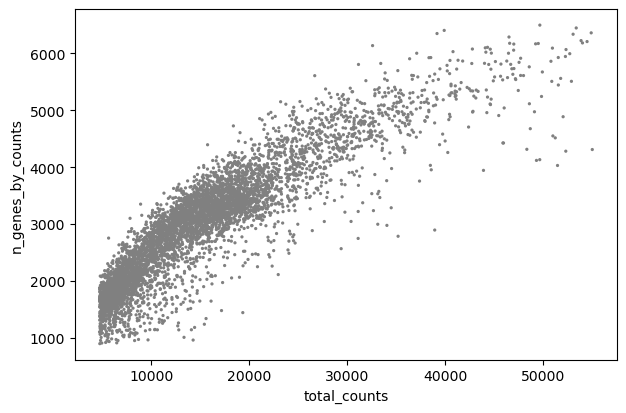

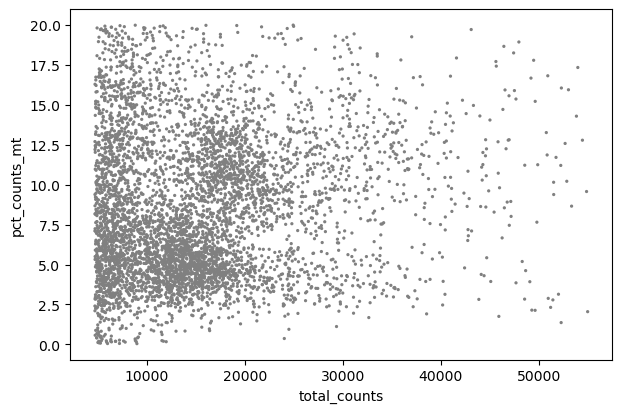

AnnData object with n_obs × n_vars = 5507 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics after applying QC
data_quality_control_check(adata63)

#### Sample 74

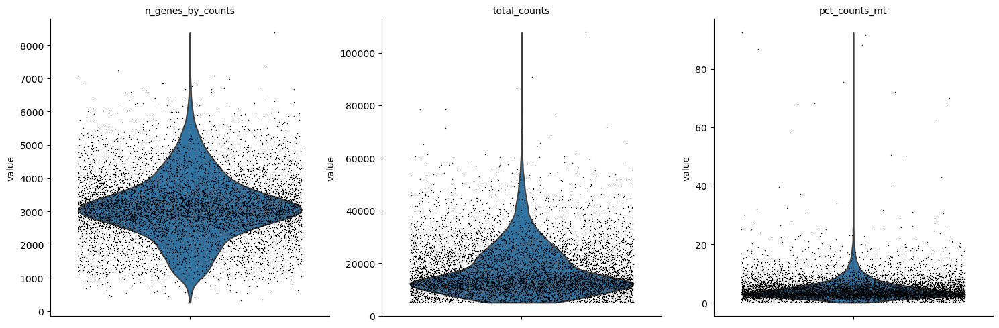

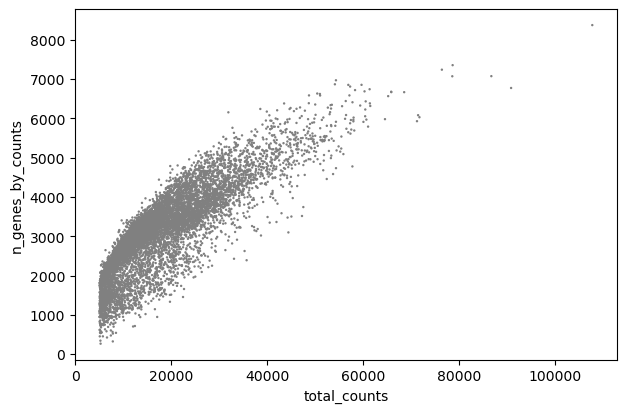

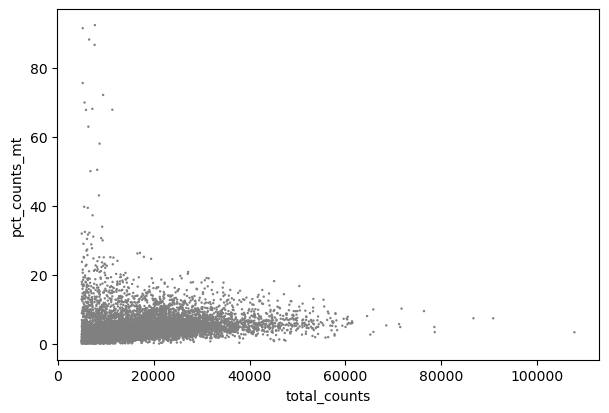

AnnData object with n_obs × n_vars = 10021 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics
data_quality_control_check(adata74)

In [ ]:
# Apply selected QC values
adata74 = data_quality_control_apply(adata74, min_counts=200, max_counts=55000, min_genes=1000, max_genes=6000, max_pct_mt=20)
adata74

Total number of cells before filtering: 10021
Number of cells after min count filter: 10021
Number of cells after max count filter: 9971
Number of cells after gene filter: 9854
Number of cells after gene filter: 9824
Number of cells after MT pct filter: 9762


AnnData object with n_obs × n_vars = 9762 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

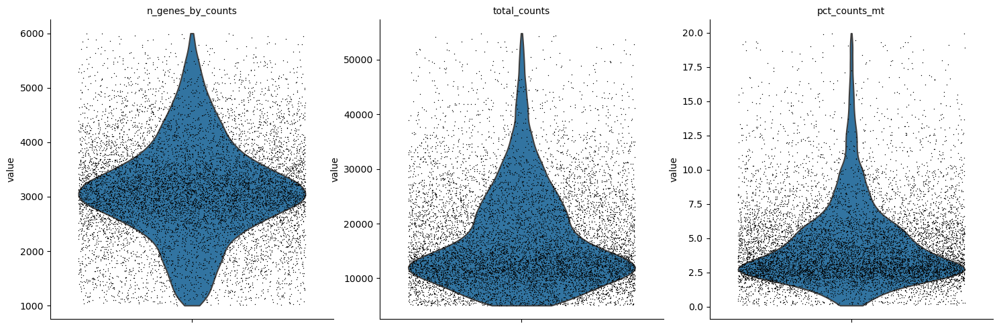

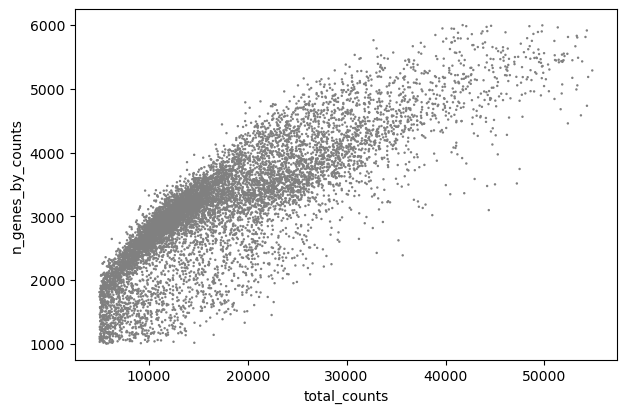

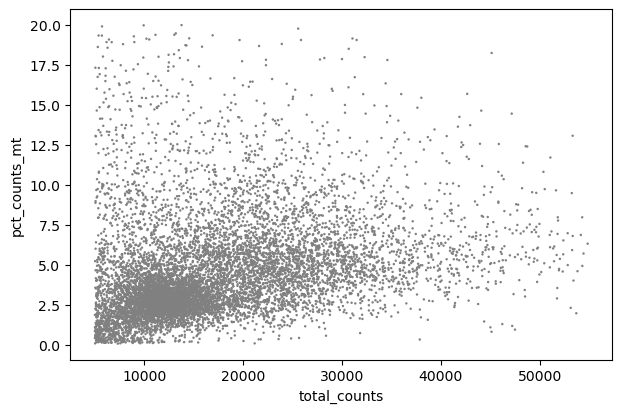

AnnData object with n_obs × n_vars = 9762 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
# Calculate and visualize QC metrics after applying QC
data_quality_control_check(adata74)

#### Integrating Datasets

After performing quality control on each sample, here, I integrated all the samples back into one AnnData object. I performed one more quality control metric, which is filtering out genes expressed in less than 30 cells in the total dataset, which indicates that those genes are probably artifacts.

In [ ]:
# Concatenate all the samples from donors we have (22, 24, 61, 63, 74) in adata_all
adata = anndata.concat(
    {bc: ad for bc, ad in zip(['22', '24', '61', '63', '74'], [adata22, adata24, adata61, adata63, adata74])},
    label='sample',
    merge="same"
)
adata

AnnData object with n_obs × n_vars = 31863 × 32738
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt'

In [ ]:
# Filter genes

print('Total number of genes: {:d}'.format(adata.n_vars))

# Basic filtering - a Gene must be at least detected in 30 cells
sc.pp.filter_genes(adata, min_cells=30)

print('Number of genes after filtering: {:d}'.format(adata.n_vars))

Total number of genes: 32738
Number of genes after filtering: 18977


<a id='32'></a>
## 3.2. Normalization and Logarithmizing

#### Normalizing

Here, I normalized the total count data matrix X to 10,000 reads per cell, so that counts become comparable among cells. However, I kept the count data that is not normalized or logarithmized in a count layer first, which I used in a later section. 

In [ ]:
# Keep the count data in a counts layer.
adata.layers["counts"] = adata.X.copy()

In [ ]:
# Total-count normalize (library-size correct) the data matrix X to 10,000 reads per cell.
sc.pp.normalize_total(adata, target_sum=1e4)

#### Logarithmizing

Here, I logarithmized the data. After that, I saved the normalized and logarithmized raw data in the .raw attribute of the Anndata. This is in case I want to use it later for other analysis purposes such as differential testing and visualizations of gene expression or gene network and trajectory analysis. The steps below where I did data correction for clustering might affect the results of these analyses.

In [ ]:
# Logarithmize the data
sc.pp.log1p(adata)

In [ ]:
# Save the normalized and logarithmized raw data in the .raw attribute of the anndata.
adata.raw = adata

<a id='4'></a>
# 4. Feature Engineering, Dimentionality Reduction, and Systematic Correction

In this section, I performed several essential processing steps to refine the scRNA-seq data for deeper analysis, such as identifying genes with high variability across cells, linear dimensionality reduction with Principal Component Analysis (PCA), calculating the neighbors graph of cells, non-linear dimensionality reduction for visualization in 2 dimensions using Uniform Manifold Approximation and Projection (UMAP), and batch correction among the five samples after exploratory analysis.

<a id='41'></a>
## 4.1. Identify highly-variable genes

Here, I identified and extracted genes with high variability across cells or highly variable genes (HVGs). These genes are key to distinguishing the data's different cell types or states. I used the  Scanpy's $pp.highly-variable-genes$ function. For each gene, the function calculates measures of variability, based on the mean expression and dispersion (variance relative to mean) of the gene across all cells. It then selects genes that are highly variable based on specified criteria. These criteria often include thresholds for minimum and maximum mean expression levels and a minimum level of dispersion. The idea is to focus on genes that are not just highly expressed or variable by chance but are genuinely differentially expressed across the dataset. I then visually inspected selected genes to ensure robust selection criteria. Following this, I filtered the dataset to retain only these HVGs, thereby reducing dimensionality and enhancing the focus on biologically informative features.

Next, I regressed out the confounding factors like total counts per cell and mitochondrial gene percentages to minimize technical biases. The goal is to ensure that the variations observed in the data are predominantly due to biological differences between cells, not technical artifacts. Regressing out confounding factors works as follows:

1- Identifying Confounders: Common confounders include the total number of RNA molecules detected in a cell (total counts) and the percentage of counts attributed to mitochondrial genes (pct_counts_mt). High mitochondrial gene expression can indicate cell stress or death, while variations in total counts can arise from differences in sequencing depth or efficiency.

2- Modeling the Effect: For each gene, a model is constructed that explains its expression as a function of the confounders. Essentially, this model predicts what the gene's expression would be based solely on the levels of the confounding variables. This is done using linear regression, where the confounders are the independent variables, and the gene expression levels are the dependent variable. Suppose we have a gene expression matrix X, where each row represents a gene and each column represents a cell. Let $X_{ij}$ be the expression level of gene j in cell i. Let these confounders be represented by the vectors C (total counts) and M (percentage of mitochondrial counts) respectively. The basic idea is to model the gene expression $x_{ij}$ as a linear combination of the confounders plus an error term that represents the biological variation we are interested in:

$ x_{ij} = β1_j ⋅ C_i + β2_j ⋅ M_i + ϵ_{ij} $

The regression process involves estimating the coefficients $β1_j$ and $β2_j$ for each gene j. This is typically done using ordinary least squares regression, where the objective is to minimize the sum of the squared residuals:

$ min_{β1_j , β2_j}  ∑_i (x_{ij} − β1_j ⋅ C_i − β2_j ⋅ M_i)^2 $


3- Subtracting the Predicted Effect: Once the coefficients are estimated, we can calculate the corrected gene expression, $  \tilde{x}_{~ij}$ which is the part of $x_{ij}$ not explained by the confounders:

$\tilde{x}_{ij} = x_{ij} - (\hat{\beta}1_{j} \cdot C_i + \hat{\beta}2_{j} \cdot M_i)$

Where $ \hat{\beta}1_{j} $ and $ \hat{\beta}2_{j} $ are the estimated coefficients. The corrected matrix $ \tilde{X} $, consisting of $ \tilde{x}_{ij} $ for each gene j and cell i, is then used for further analysis. This process effectively "regresses out" the effects of total counts and mitochondrial gene percentage, leaving behind a dataset that is more reflective of the underlying biological variance.


After that, I scaled the data to unit variance with clipping of extreme values to minimize the effect of outliers. Scaling standardizes the range of features or genes in the data by transforming the data to have a standard deviation of one. This scaling ensures that subsequent analyses, particularly those sensitive to the scale of features like PCA, are conducted on data that adheres to standard assumptions of homogeneity in variance. The overall effect of this scaling is to bring the data into a form where all features contribute equally based on their variability, not their absolute magnitude. 

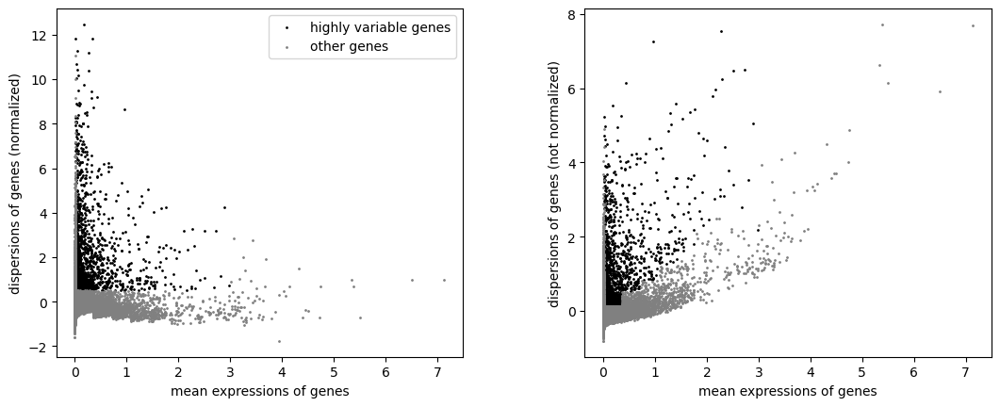

In [ ]:
# Extracting highly variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

# Visualization of highly variable genes
sc.pl.highly_variable_genes(adata)

# Get only highly variable genes
adata = adata[:, adata.var.highly_variable]

In [ ]:
# Regress out the effect of total counts per cell and the percentage of mitochondrial genes expressed
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

# Scaling the data to unit variance and clip values above standard deviation of 10.
sc.pp.scale(adata, max_value=10)

<a id='42'></a>
## 4.2. Principal Component Analysis (PCA)

Before proceeding, I did some data exploration to ensure that the data was ready for the next steps of the analysis or to identify if I needed further preprocessing such as batch correction. Thus, I made a copy of the data first for exploration.

The single-cell gene expression data includes thousands of genes even after identifying HVGs, and usually, more genes, which are the features, than cells, which are the observations. This is problematic and causes "the curse of dimensionality", where the learned hypothesis may fit the training set very well but fail to generalize to new examples. To tackle this problem, I used linear dimensionality reduction, particularly Principal Component Analysis (PCA). PCA transforms the original gene expression data into a new coordinate system with fewer dimensions (principal components), capturing the most significant variance in the data. 

Using the $tl.pca$ function in Scanpy, I computed the first 100 principal components of my dataset. Mathematically, PCA works as follows:

1- Center scaled data: Subtract the mean of each gene (variable) from the dataset to center the data around the origin. I scaled the data earlier.
$$ X_{centered} = X - \bar{X} $$ 

2- Covariance Matrix Calculation: Calculate the covariance matrix of the centered data. The covariance matrix represents how each pair of genes varies together.
$$ Cov(X) = \frac{1}{n-1} X_{centered}^T X_{centered} $$

3- Eigen Decomposition: The covariance matrix is then subjected to eigen decomposition, yielding eigenvalues and eigenvectors:
$$ Cov(X) = V \cdot diag(\lambda) \cdot V^T $$
Here, V represents the matrix of eigenvectors (principal components), and $diag(\lambda)$ is the diagonal matrix of eigenvalues $\lambda$, which represents the amount of variance in the original data that is captured by the corresponding principal component.

4- Data Projection: The original data is projected onto the new principal components, effectively transforming the data into the PCA space:
$$ X_{pca} = X_{centered} \cdot V $$
The number of principal components selected in this step is based on their contribution to variance as described in the next point.

5- Variance Ratio Visualization: I visualized the variance ratio for each principal component, represented in the eigenvalues, using Scanpy's $pl.pca-variance-ratio$ function. This elbow plot is a useful heuristic that helps in determining the optimal number of components to retain, chosen at the point where additional components contribute minimally to explaining variance. However, this number is still somewhat subjective.

Based on the elbow plot, I chose to proceed with the first 50 principal components that contribute maximally to explaining variance. This number of PCs also aligns with the conventions in the field.

In [ ]:
# make a copy of the data to explore without affecting original data 
adata_explore = adata.copy()

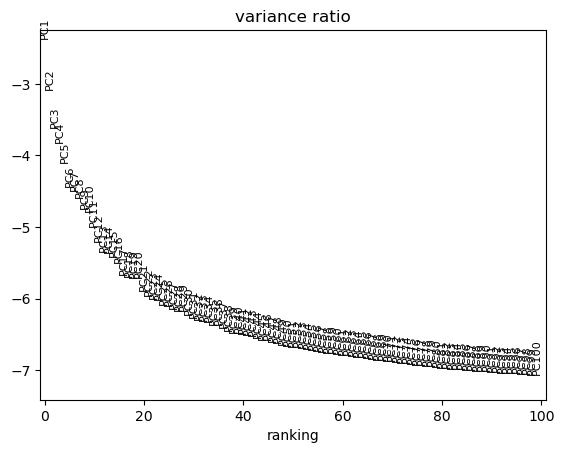

In [ ]:
# Performing Principal Component Analysis (PCA)
sc.tl.pca(adata_explore, n_comps=100, svd_solver='arpack')

# Visualize elbow plot for the variance ratio across principal components
sc.pl.pca_variance_ratio(adata_explore,n_pcs=100, log=True)

<a id='43'></a>
## 4.3. Neighborhood Graph Construction

After reducing the high-dimensional gene expression data to a lower-dimensional space using PCA with 50 dimensions, here, I  computed the neighborhood graph of cells. I used the function $sc.pp.neighbors$ in Scanpy. It computes the neighborhood graph in this lower-dimensional space as follows:

1- Nearest Neighbor Search: For each cell, it identifies other cells that are 'close' in terms of their gene expression profiles, considering only the first 50 PCs. Mathematically, if we denote the PCA-reduced data as $X_{PCA}$ with dimensions $ n \times 50 $ (where $ n $ is the number of cells). The aim is to find for each row $x_i$ in $X_{PCA}$ the nearest rows $\{x_{i1}, x_{i2}, ..., x_{ik}\}$ based on a distance metric, typically Euclidean.

2- Distance Metric: The Euclidean distance is used here to measure closeness between cells. The Euclidean distance between two points $x_i$ and $x_j$ in the PCA space is calculated as:
$$  d(x_i, x_j) = \sqrt{\sum_{k=1}^{50} (x_{ik} - x_{jk})^2} $$
Here, $x_{ik}$ and $x_{jk}$ represent the values of the k-th principal component for cells i and j, respectively.

3- Graph Construction: After identifying the nearest neighbors for each cell, a graph or a network is constructed where each node represents a cell, and edges connect each cell to its nearest neighbors. This graph captures the local structure of the data, highlighting how cells are related based on their gene expression patterns.

One other parameter that is important here, besides the number of PCs, is the number of neighbors $(n-neighbors)$. This parameter determines the size of the local neighborhood around each point. A smaller value focuses on local structure, leading to more emphasis on cluster formation. Larger values can help reveal the global data structure but might mix distinct clusters. Choosing an appropriate value depends on the balance we want to strike between highlighting local versus global structures in the data. Here, I chose to proceed with the recommended or default value of this parameter in Scanpy, n_neighbors=15.

This neighborhood graph is important for algorithms used later like UMAP and Louvain clustering. In a sense, this step prepares scRNA-seq data for analyses requiring insights into cell relationships and proximities, using dimensionality reduction and neighborhood graph construction.

In [ ]:
# Calculate the neighborhood graph with 50 PCs. 
sc.pp.neighbors(adata_explore, n_pcs=50) # n_neighbors = 15 by default.

<a id='44'></a>
## 4.4. Uniform Manifold Approximation and Projection (UMAP)

After calculating the neighborhood graph, I wanted to embed it into two dimensions to visualize it. To do so, I used a non-linear dimensionality reduction technique. Two commonly used techniques in the field are Uniform Manifold Approximation and Projection (UMAP) and t-Distributed Stochastic Neighbor Embedding (t-SNE). Here, I chose UMAP for two main reasons among others:

1- Preservation of Global Structure: UMAP is generally better at preserving both local and global structures of the data. t-SNE excels at revealing local structures and clusters, but it can sometimes exaggerate the distances between clusters, distorting the global structure. UMAP balances the preservation of local and global relationships, providing a more comprehensive view of the data.

2- Efficiency: UMAP works faster than t-SNE, especially with the large size of scRNA-seq datasets. This is due to UMAP's more efficient mathematical framework and optimizations.

UMAP begins by assuming that the high-dimensional data lies on a manifold within the higher-dimensional space and seeks to learn the manifold's structure. The UMAP algorithm works as follows:

1- Neighborhood Graph: UMAP uses the High-Dimensional Neighborhood Graph that is calculated above. The calculated distances between points are used to calculate a weight for each edge in the graph, typically using a Gaussian kernel. It is the exponential of the negative distance between a given two points, scaled by a local parameter σ: 

$$ w_{ij} = \exp\left(-\frac{{\|x_i - x_j\|^2}}{\sigma_i}\right) $$

Where, $w_{ij}$ represents the weight between points $x_i$ and $x_j$, and $\sigma_i$ is a local scaling parameter chosen such that the local UMAP view of each data point $x_i$ approximately equals its k-nearest neighbors. It adjusts the focus from local (smaller $σ$) to more global (larger $σ$) features of the data.

2- Fuzzy Set Representation: UMAP translates this graph into a fuzzy set. Each point in the data is assumed to have a fuzzy membership to its neighboring points, where each edge's weight calculated above represents the probability of connection between points.
The probability of $x_i$ connecting to $x_j$ in the high-dimensional space is given by: $p_{ij} = w_{ij}$ .
And symmetrically for $ x_j$ connecting to $x_i$:
$p_{ji} = w_{ji}$.

This forms a symmetric matrix $P$ of connection probabilities. This step is crucial as it is the basis for preserving topological structures in the data during the dimensionality reduction process.

3- Low-Dimensional Representation: UMAP then seeks a low-dimensional representation $Y$ of the data, where each $y_i$ corresponds to $x_i$ in the high-dimensional space. The goal is to configure $Y$ such that the probabilities of connection between points in $Y$ mirror those in $P$.

4- Optimization with Cross-Entropy Minimization: The layout of points in $Y$ is optimized by minimizing the cross-entropy between the high-dimensional fuzzy set and a similar set in the low-dimensional space. This is a non-linear optimization problem, typically solved using stochastic gradient descent. If $q_{ij}$ represents the probability of connection between points in $Y$, the cross-entropy to minimize is:
 $$ C = \sum_{i \neq j} [p_{ij} \log(\frac{p_{ij}}{q_{ij}}) + (1 - p_{ij}) \log(\frac{1 - p_{ij}}{1 - q_{ij}})] $$
This optimization ensures that the local and global structure of the data is preserved as much as possible in the lower-dimensional representation.

5- Visualization: The final output is a 2D embedding $Y$ suitable for visualization and further analysis, where similar data points in the high-dimensional space are placed close together in the low-dimensional space. However, it is important to note that while UMAP preserves local and global structures, the exact distances and cluster sizes in the 2D space may not have a direct interpretation in terms of the original high-dimensional space. 

Overall, UMAP finds the best low-dimensional (2D) representation of the data that preserves both local neighborhood relations and the broader topological structure of the high-dimensional space. This makes it particularly effective for revealing inherent patterns and structures in complex datasets like scRNA-seq data by visualizing it in a way that we can see.

Here, I used the Scanpy's $tl.umap$ function. One important parameter, besides n_neighbors used earlier in graph construction, is $min-dist$. It is the effective minimum distance between embedded points. It controls how tightly UMAP is allowed to pack points together. Lower values result in more clumped embedding where nearby points on the manifold are drawn closer together, and thus, tighter clusters, which can be useful for identifying subtle structures. Higher values allow points to spread out more, which can help in visualizing the overall structure of the data. Here, I chose to stick with the default value of 0.5 which is the convention in the field.

I visualized the results after the UMAP calculation. I highlighted the different five samples in the dataset in the UMAP visualization.

In [ ]:
# UMAP calculation
sc.tl.umap(adata_explore) # min_dist = 0.5 by default

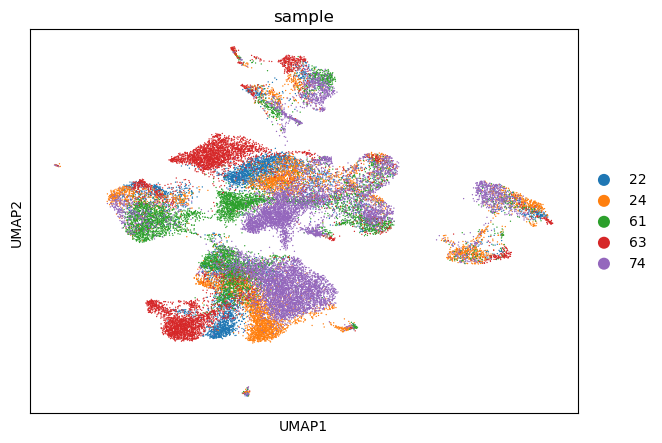

In [ ]:
# Visualize the UMAP with highlighting the different five samples in the dataset
sc.pl.scatter(adata_explore, basis='umap', color='sample')

<a id='45'></a>
## 4.5. Batch Correction

From the UMAP plot above, we can clearly notice batch effects between our five samples in the data as points from different samples form visually separable clusters. Batch effects are systematic differences in data that arise not from biological variations but from technical or experimental differences, such as different sample preparations, sequencing runs, or lab conditions. If there were no batch effects, the points from the different five samples would ideally mix together well and not form visually seperable clusters. That is because of the assumption that different samples come from the same underlying biological process.

We need to solve this problem. Batch correction in scRNA-seq is a critical step for ensuring that subsequent analyses reflect true biological differences rather than technical artifacts. However, it is important to avoid overcorrection as this might remove genuine biological variability. Thus, we should carefully select an appropriate batch correction technique.

A common statistical method in the field is Combating Batch Effects (ComBat), which uses an empirical Bayes framework to model and adjust for batch effects in gene expression data. This method leverages the strengths of both frequentist (data-driven estimation) and Bayesian (prior and posterior updating) methods, making it particularly effective for high-dimensional genomic data where direct parameter estimation might be challenging (Zhang et al., 2020). ComBat works as follows:

1- Model Formulation: It formulates a model that includes parameters for both the biological covariates and the batch effects, as follows: 
$$ Y_{ij} = μ + α_j + β_i + ε_{iJ} $$  
Where,
- $Y_{ij}$ is the logged expression level of gene  $j$ in sample $i$
- $μ$ is the overall mean expression of the gene across all samples.
- $α_j$ is the biological effect of the j-th gene.
- $β_i$ is the batch effect for the i-th sample.
- $ϵ_{ij}$ is the residual error, assumed to be normally distributed.

2- Empirical Bayes Estimation: In a fully Bayesian approach, priors for these parameters are specified based on prior knowledge. Empirical Bayes simplifies this by estimating priors directly from the observed data. ComBat uses the Empirical Bayes approach as it involves estimating the prior distributions of parameters based on the observed data.

- Batch effects: It assumes that batch effects $β_j$ come from a shared normal distribution with a mean of zero $N(0, σ_β^2)$. The variance $σ_β^2$ is estimated from the data.

- Gene effects: Similarly, gene effects $α_i$ are also modeled with a shared normal distribution, with its own variance $σ_α^2$  estimated from the data.

The concept of "borrowing strength" comes into play here. ComBat assumes that the batch effects for all genes come from a shared distribution. This means that the information from all genes is pooled to estimate the distribution of batch effects. That allows for individual differences in batch effects for each gene but informs the estimation for each batch effect from the collective behavior of all batches. The "borrowing strength" way is especially useful when some genes are not highly expressed or when sample sizes are small, especially when dealing with high-dimensional data, like gene expression, where the number of features (genes) far exceeds the number of samples (Zhang et al., 2020). 

3- Updating with Bayes' Theorem: ComBat then uses Bayes' theorem to update these priors into posterior estimates for each gene’s batch effects.

$$ P(β_i | Y) ∝ P(Y | β_i) * P(β_i)$$ 

Where, $P(β_i ∣ Y)$ is the posterior probability of the batch effect given the observed data, $P(Y ∣ β_i)$ is the likelihood of the observed data given the batch effect, and $P(β_i)$ is the prior probability of the batch effect (estimated empirically).

The posterior estimates for each gene's batch effects are "shrunk" towards the mean of the shared distribution. This shrinkage is more pronounced for genes with less clear batch effects, preventing over-adjustment based on noisy or limited data. For genes with strong and clear batch effects, the posterior estimates will be notably different from the priors, whereas for genes with ambiguous batch effects, the posteriors will align more closely with the empirical priors. 


5- Adjusting the Data: Finally, the original gene expression data is adjusted by removing the estimated batch effects, resulting in batch-corrected data.
$$ Y_{ij}^{adjusted} = Y_{ij} - \hat β_i $$

This adjustment aims to retain biological variability while reducing technical variability, enhancing the validity of downstream analyses. ComBat's empirical Bayes approach, with its balance of data-driven estimation and Bayesian updating, is adept at mitigating overfitting and ensuring that adjustments are reflective of broader data trends.

Here, I used Scanpy's $pp.combat$ function to apply ComBat batch correction to the data. Then, I applied the same PCA, neighborhood graph, and UMAP calculations that I applied to the exploratory copy of the data to the original copy.

In [ ]:
# Batch Correction using ComBat
sc.pp.combat(adata, key='sample')

In [ ]:
# Performing Principal Component Analysis (PCA)
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')

In [ ]:
# Calculate the neighborhood graph with 50 PCs. 
sc.pp.neighbors(adata, n_pcs=50) # n_neighbors = 15 by default.

In [ ]:
# UMAP calculation
sc.tl.umap(adata)  # min_dist = 0.5 by default

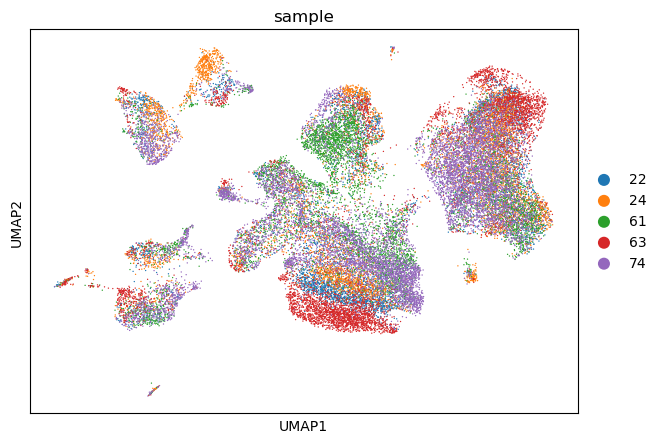

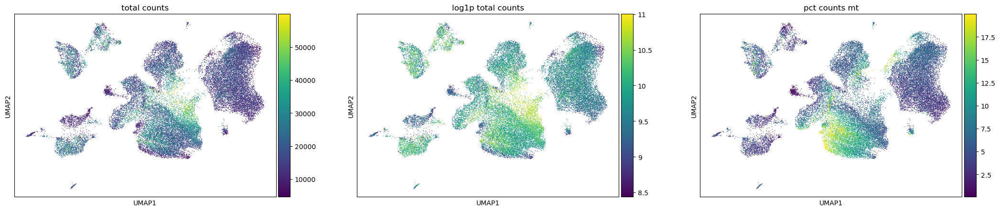

In [ ]:
# Visualize the UMAP with highlighting the different five samples in the dataset
sc.pl.scatter(adata, basis='umap', color='sample')
# Visualizing the distribution of data quality metrics in the UMAP 
sc.pl.scatter(adata, basis='umap', color=[ 'total_counts', 'log1p_total_counts', 'pct_counts_mt'])

As we can observe in the UMAP plot, I could effectively overcome the batch effects. That is because the points from the different five samples mix well together in this UMAP plot. Additionally, data quality metrics, such as read depth and mitochondrial gene percentage, are uniformly distributed across the data.

One important consideration is that batch correction methods such as ComBat can introduce small non-zero values in the count matrix where there were originally zeros. This is known as 'smoothing', a side effect of the model trying to adjust the data based on the estimated batch effect parameters. To mitigate this, after applying ComBat, I took a careful post-correction step to reset the originally zero values. I set the values that were zeros in the original count matrix, which I saved earlier in a counts layer (adata.layers['counts']), back to zero in the adjusted matrix (adata.X). This step is crucial because zero counts carry biological significance in scRNA-seq data, often indicating the absence of gene expression. Altering these values can have unintended consequences on downstream analyses, such as differential expression testing, which relies on the accurate representation of zero and non-zero counts. Furthermore, scRNA-seq datasets are typically large and sparse, with a majority of zero counts. Maintaining this sparsity is not only a matter of computational efficiency for storage and analysis but also a reflection of the underlying biology. I also ensured that the data matrix remains in a sparse format by converting the adjusted count matrix back into a Compressed Sparse Row (CSR) matrix, which is efficient for storage and computation.

In [ ]:
# Ensuring that the data matrix remains sparse
adata.X = csr_matrix(adata.X)

# Setting values in adata.X back to zero where they were zero in the original count matrix 
adata.X[adata.layers['counts']==0] = 0

In [ ]:
adata

AnnData object with n_obs × n_vars = 31863 × 1581
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

#### Save Preprocessed Data

In [ ]:
adata.write('./GSE198623_preprocessed_data.h5ad')

<a id='5'></a>
# 5. Task Definition and Data Partitioning

<a id='51'></a>
## 5.1. Task Definition

In the next sections, I delve more into the core task of my analysis: clustering single-cell RNA sequencing data of human pancreatic islets. This unsupervised machine learning task is crucial in scRNA-seq analysis as it helps uncover distinct cell populations or subtypes based on their gene expression profiles. In other words, the primary objective of clustering in scRNA-seq data is to group cells that exhibit similar gene expression patterns. This approach is significant in my scHAMR pipeline that I discussed earlier so that I can compare and contrast RNA covalent modifications among different cell types and states. This is the core of adding that "single-cell resolution" to the analysis. In the broader field, this clustering task aims to:

- Discover Cellular Heterogeneity: Uncovering the diverse cell types and subtypes present in the sample is crucial in understanding complex tissues, especially in contexts like tumor heterogeneity in cancer studies.
- Understand Biological Processes: Clustering serves as a foundational step for further analyses, such as differential gene expression analysis between clusters, which can reveal key genes driving cellular differences. By grouping cells with similar expression profiles, we can infer functional relationships, understand developmental trajectories, and identify new cell states or transitions.  

In this paper, I focused on the first point as I compared different marker genes among those clusters of different cell types to annotate cell types. This helps us understand the amazing heterogeneity of cell populations and subpopulations in the pancreas tissue.

<a id='52'></a>
## 5.2. Stratified Data Subsets

This is an unsupervised machine learning task, and thus, there is no training involved. However, I wanted to assess whether the clustering model that I applied in a later section is consistent, stable, and robust. To assess this, I splited the data into subsets, performed clustering independently on each subset, and compared the clustering outcomes across the subset and with the original full data. Having consistent clustering across these datasets would indicate that the model is indeed robust.

One approach is to randomly split the data. However, this can be problematic because there might be some rare types of cells that get completely assigned to one subset but not the other. I wanted to have the subsets representative of the original data. Thus, I used stratified sampling to ensure that each region in the UMAP space is proportionally represented in both subsets. This is crucial for maintaining the underlying structure and diversity of the cell populations in each subset.

To perform stratified sampling, I did the following:
- I created a grid of bins (100 bins along each axis) in the UMAP space of the data, assigning each cell to a bin based on its UMAP coordinates.
- I assigned a unique stratification key created for each cell by combining its x and y bin indices. This key helps in identifying the specific bin each cell belongs to.
- For cells in bins with at least two samples, I used StratifiedShuffleSplit to evenly distribute cells across two subsets, ensuring each bin's representation is maintained.
- For cells in bins with only one sample, I randomly assigned them to one of the two subsets using train_test_split.
-  Finally, I combined cells from both stratified and random splits to form two comprehensive subsets of the original data.

In [ ]:
# Define bins or regions for splitting

# Get UMAP coordinates
umap_coords = adata.obsm['X_umap']

# Define grid boundaries (these could be based on quantiles or other criteria)
x_bins = np.linspace(min(umap_coords[:,0]), max(umap_coords[:,0]), 100)
y_bins = np.linspace(min(umap_coords[:,1]), max(umap_coords[:,1]), 100)

# Digitize the UMAP coordinates to bin indices
x_bin_indices = np.digitize(umap_coords[:,0], x_bins)
y_bin_indices = np.digitize(umap_coords[:,1], y_bins)

# Combine the bin indices to form a stratification key
stratification_key = x_bin_indices * (1000) + y_bin_indices

In [ ]:
# Splitting the data into two subsets. Here, we perform stratified splitting. 
# However, if a bin has only one sample, we randomly assign the sample to a subset.

# Check if any bin has fewer than 2 samples
unique, counts = np.unique(stratification_key, return_counts=True)
# Find bins with fewer than 2 samples
bins_with_fewer_than_two = unique[counts == 1]

# Create masks for cells in bins with at least two samples and with only one sample
mask_fewer_than_two = np.isin(stratification_key, bins_with_fewer_than_two)
mask_at_least_two = ~mask_fewer_than_two

# Split indices into two groups
indices_fewer_than_two = np.where(mask_fewer_than_two)[0]
indices_at_least_two = np.where(mask_at_least_two)[0]

# Perform stratified split on cells in bins with at least two samples
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.5, random_state=42)
for first_subset_idx_stratified, second_subset_idx_stratified in sss.split(X=np.zeros(
    len(indices_at_least_two)), y=stratification_key[mask_at_least_two]):
    pass

# Adjust indices to original data
first_subset_idx_stratified = indices_at_least_two[first_subset_idx_stratified]
second_subset_idx_stratified = indices_at_least_two[second_subset_idx_stratified]

# Randomly assign cells from bins with fewer than two samples
first_subset_idx_random, second_subset_idx_random = train_test_split(indices_fewer_than_two, test_size=0.5, random_state=42)

# Combine indices from both stratified and random splits
first_idx = np.concatenate((first_subset_idx_stratified, first_subset_idx_random))
second_idx = np.concatenate((second_subset_idx_stratified, second_subset_idx_random))

# Create First and Second subsets
first_subset_adata = adata[first_idx].copy()
second_subset_adata = adata[second_idx].copy()

In [ ]:
print(first_subset_adata,'\n \n', second_subset_adata)

AnnData object with n_obs × n_vars = 15931 × 1581
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities' 
 
 AnnData object with n_obs × n_vars = 15932 × 1581
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'ensembl_ID', 'mt', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

<a id='6'></a>
# 6. Clustering Models Selection

<a id='61'></a>
## 6.1. Louvain Model

The first model I chose for my analysis is Louvain, which is a popular method for community detection in networks and is particularly effective in clustering scRNA-seq data. The Louvain algorithm is an unsupervised learning technique, meaning it doesn't require pre-labeled data. It identifies clusters or communities in large networks based on modularity optimization.

**Core Ideas and Mathematical Underpinnings**:

The Louvain algorithm works on the principle of modularity maximization. Modularity measures the density of links inside communities compared to links between communities. Mathematically, the modularity of a partition of nodes in a network is given by:
$$
Q = \frac{1}{2m} \sum_{ij} \left[ A_{ij} - \frac{k_i k_j}{2m} \right] \delta(c_i, c_j)
$$
Where:

- $A_{ij}$ represents the weight of the edge between nodes $i$ and $j$.
- $k_i$ and $k_j$ are the sum of the weights of the edges attached to nodes $i$ and $j$.
- $m$ is the sum of all the edge weights in the network.
- $c_i$ and $c_j$ are the communities of the nodes $i$ and $j$.
- $\delta$ is the Kronecker delta function, which is 1 if $c_i = c_j$ and 0 otherwise.

Based on this equation, the modularity of a community $c$ can be calculated as:
$$
Q_c = \frac{\Sigma_{in}}{2m} - \left(\frac{\Sigma_{tot}}{2m}\right)^2
$$

Where:
- $\Sigma_{in}$ is the sum of edge weights between nodes within the community $c$ (each edge is considered twice).
- $\Sigma_{tot}$ is the sum of all edge weights for nodes within the community, including edges linking to other communities.


**Algorithm Overview**:

- Initialization: It takes the neighborhood graph I calculated earlier as an input. It assigns each node to its own initial community.
- First Phase, Modularity Maximization: For each node $i$, the change in modularity is calculated if the node were to be moved to the community of each neighbor $j$. This change in modularity, $\Delta Q$, for moving node $i$ into the community of node $j$ is calculated as follows:
$$
   \Delta Q = \left[\frac{\Sigma_{in} + 2k_{i,in}}{2m} - \left(\frac{\Sigma_{tot} + k_i}{2m}\right)^2\right] - \left[\frac{\Sigma_{in}}{2m} - \left(\frac{\Sigma_{tot}}{2m}\right)^2 - \left(\frac{k_i}{2m}\right)^2\right]
$$ 
Here, $\Sigma_{in}$ is the sum of all the links weights inside the new community of $i$, $\Sigma_{tot}$ is the sum of all the weights of the links to nodes in the new community of $i$, $k_i$ is the weighted degree of $i$, and $k_{i,in}$ is the sum of the weights of the links between $i$ and other nodes in the community.

- Second Phase, Aggregation: Once all nodes are processed, a new network is created. Each community in the original network becomes a node in the new network, and the weights of the edges between the new nodes are the sum of the edge weights between nodes in the corresponding communities.

- Iteration: The first and second phases are repeated iteratively until modularity cannot be increased further.

**Optimization Function**:

Modularity is a scale value between −0.5 (non-modular clustering) and 1 (fully modular clustering) that measures the relative density of edges inside communities with respect to edges outside communities. As discussed earlier, the algorithm aims to maximize modularity.


Louvain Algorithm Overview [source: Traag et al. (2019)]: 

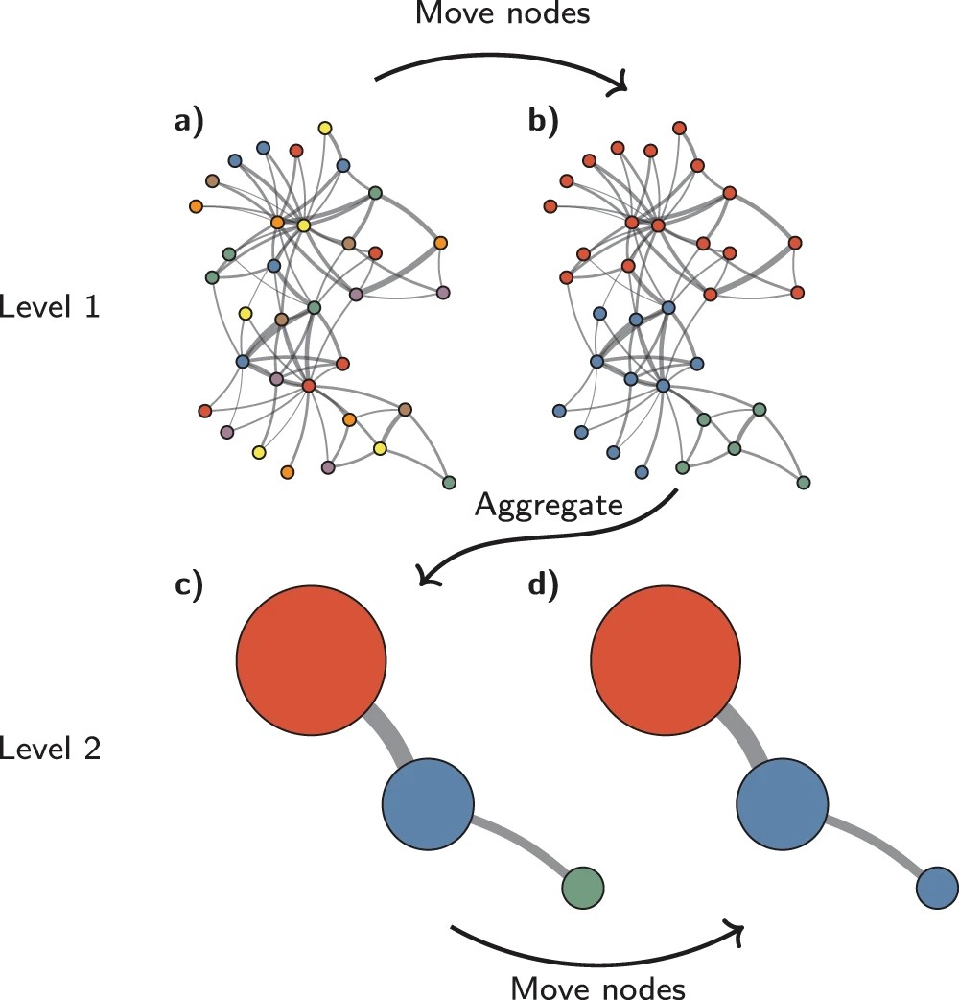

In [ ]:
display(Image(filename='./images/fourth pic.png', width=500, height=1000))

**Advantages**:
- Efficiency and Scalability: Louvain is computationally efficient, making it suitable for large-scale networks. It quickly identifies communities through its iterative optimization process. Its greedy optimization method runs in time $O(n\cdot \log n)$ where $n$ is the number of nodes in the network. It thus can handle very large networks, scaling well as the size of the network increases in scRNA-seq data.
- Effectiveness: It generally produces high-quality community divisions, maximizing modularity effectively and often uncovering meaningful community structures within networks.
- Simplicity: It is relatively simple to understand and implement.

**Disadvantages**:
- Resolution Limit: It may merge smaller communities into larger ones, potentially obscuring detailed community structures. I was careful with tuning the resolution parameter in the next section.
- Non-overlapping Communities: Louvain produces only non-overlapping communities, which means that each node can belong to at most one community. This is highly unrealistic in many real-world applications such as in social sciences or biological gene pathways, where a gene can belong to more than one pathway. However, in our specific application, this is not a problem. That is because a given cell can only be one type.
- Badly Connected Communities: Louvain may form communities that are internally weakly connected, potentially leading to misleading interpretations of the network's true structure. This aspect of the algorithm has been improved in more advanced algorithms like Leiden, which I explored next.

<a id='62'></a>
## 6.2. Leiden Model

The second model I chose for my analysis is Leiden, which is a community detection method in the network like the Louvain algorithm and it is also particularly effective for clustering single-cell RNA sequencing (scRNA-seq) data. The Leiden algorithm is an extension and improvement of the Louvain method, designed to overcome some of its limitations, particularly the resolution limit and the formation of weakly connected communities internally, through the addition of a refinement step.

**Core Ideas and Mathematical Underpinnings**:

The core mathematical principles of the Leiden algorithm are similar to those of Louvain, focusing on modularity optimization. However, Leiden introduces a refinement step that significantly changes the quality of the community detection process. After the initial phase, where communities are detected through modularity maximization (similar to the Louvain method), the Leiden algorithm proceeds to the refinement phase. This phase ensures that each detected community is a connected component, meaning there's a path between every pair of nodes within the community. The key steps involve:

1- Subgraph Identification: For each community detected in the previous phase, Leiden identifies subgraphs within it. These subgraphs are essentially smaller communities within the larger community. The identification of subgraphs is based on the connectivity of the nodes. Leiden ensures that each subgraph is a connected component, a path exists between any pair of nodes within the subgraph.

2- Modularity Gain for Merging Subgraphs: The algorithm then evaluates these subgraphs to determine if they should be established as independent communities. This evaluation is based on whether moving nodes between these subgraphs can further improve the overall modularity of the network. This modularity gain is calculated similarly to the initial phase, using the modularity formula I discussed earlier. If moving a node between subgraphs within a community increases the modularity, the algorithm proceeds with this reassignment.

3- Iterative Refinement: This process is applied iteratively to each community and its subgraphs until no further improvement in modularity is possible. The result is a set of refined communities, each of which is a connected subgraph, ensuring better internal connectivity.

The mathematical representation of the refinement step can be summarized as follows:

- Let $C$ be a community and $S_1$, $S_2$,..., $S_k$ be its subgraphs. 
- Leiden  iteratively evaluates the modularity gain $ΔQ$ for moving a node $n$ from subgraph $S_i$ to $S_j$ (where $ i ≠ j $). 
- This calculation takes into account the edges within the community $C$ and the connections of node $n$ with other nodes in subgraphs $S_1$ and $S_2$.


Through this refinement process, the Leiden algorithm further maximizes the modularity, a measure of the strength of the division of a network into communities, as it fine-tunes the community structure by ensuring that each community is as densely connected internally as possible (Traag et al., 2019).


**Algorithm Overview**:

- Initialization: Every node in the neighborhood graph is assigned to its own community just like Louvain.

- First Phase, Local Moving and Modularity Maximization: Similar to Louvain, nodes are moved to neighboring communities to maximize the modularity gain. The formula for that is the same as the one discussed in the Louvain section

- Second Phase, Refinement: This is unique to the Leiden algorithm. After the local moving phase, each community is partitioned into non-overlapping subcommunities. This refinement step elps ensure that the communities are connected, addressing a key limitation of the Louvain method.

- Third Phase, Aggregation: Similar to Louvain, an aggregated network is built, where each community in the original network becomes a node in the new network. The aggregation phase then repeats the process on this new network.

- Iteration: The algorithm iterates through these three phases until the modularity cannot be increased further.

**Optimization Function**:
Like Louvain, Leiden seeks to maximize modularity, which falls between −0.5 and 1. However, the refinement step in Leiden helps in achieving a more accurate maximization by ensuring connected communities.

Leiden Algorithm Overview [source: Traag et al. (2019)]: 

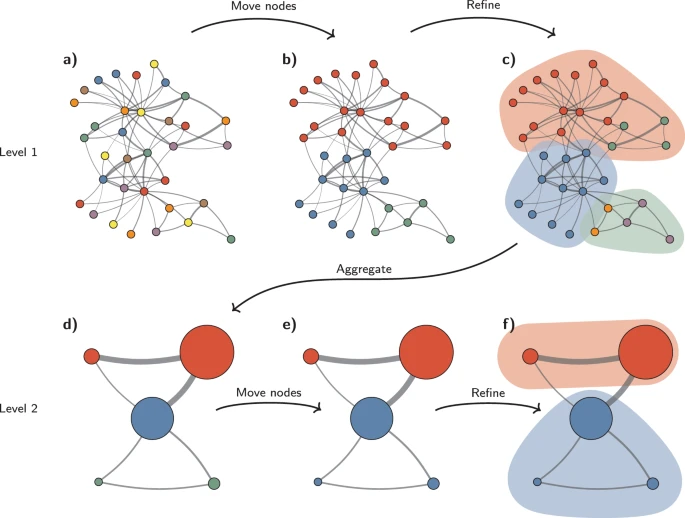

In [ ]:
display(Image(filename='./images/fifth pic.png', width=800, height=500))

**Advantages**:
- Improved Community Connectivity: Refining communities to ensure they are as densely connected internally as possible addresses one of the major limitations of the Louvain method – the formation of communities that are not internally well-connected (Traag et al., 2019).
- Efficiency and Scalability: Despite introducing an additional layer, Leiden remains efficient and scalable, suitable for large-scale networks like those encountered in scRNA-seq data. In fact, it is significantly faster than Louvain due to the refinement step (Traag et al., 2019).
- Resolution Limit Addressed: The refinement step helps address the resolution limit issue seen in Louvain, potentially providing more accurate community detection, especially in networks with a mix of large and small communities.

**Disadvantages**:
- Non-overlapping Communities: Similar to Louvain, Leiden also identifies non-overlapping communities, limiting its application in scenarios where nodes can belong to multiple communities.

<a id='7'></a>
# 7. Running the Models, Hyperparameter Tuning, and Model Evaluations

<a id='71'></a>
## 7.1. Tuning the Resolution Parameter

In this section, I ran the Louvain and Leiden models on the pre-processed scRNA-seq data. One important hyperparameter tuning here is to determine the optimal $resolution$ parameter of the Louvain and Leiden models. This parameter significantly influences the granularity of the resulting clusters. It controls the size and the number of clusters. A lower resolution tends to produce fewer and larger clusters, while a higher resolution generates more and smaller clusters. To find the optimal resolution, I evaluated the clustering quality for both models at various resolutions using the following metrics:

1- Silhouette Score: It is a measure of how similar an object is to its own cluster compared to other clusters. The value ranges from -1 to +1, where a high value indicates that the object is well-matched to its own cluster and poorly matched to neighboring clusters.

2- Davies-Bouldin Score: It is the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances. Lower Davies-Bouldin scores indicate better clustering.

3- Calinski-Harabasz Score (Variance Ratio Criterion): It compares the within-cluster dispersion with the between-cluster dispersion. Higher scores indicate better-defined clusters.

Using these three metrics together provides complementary insights and holistic evaluation. Each metric provides a different perspective on the cluster quality. Silhouette focuses on how close each point in one cluster is to points in the neighboring clusters, Davies-Bouldin emphasizes compactness and separation of clusters, and Calinski-Harabasz considers the variance ratio, which assesses the global distribution of clusters. Thus, using them together, I could validate cluster robustness.

After I calculated these metrics for different resolutions, I plotted these scores against the resolutions to visually identify the resolution that maximizes the clustering quality. Additionally, it is important to visually inspect and evaluate the results. Thus, I produced UMAP visualizations for the clustering at those different resolutions. I repeated this same analysis separately for each of the two models: Louvain and Leiden.

### Louvain Model

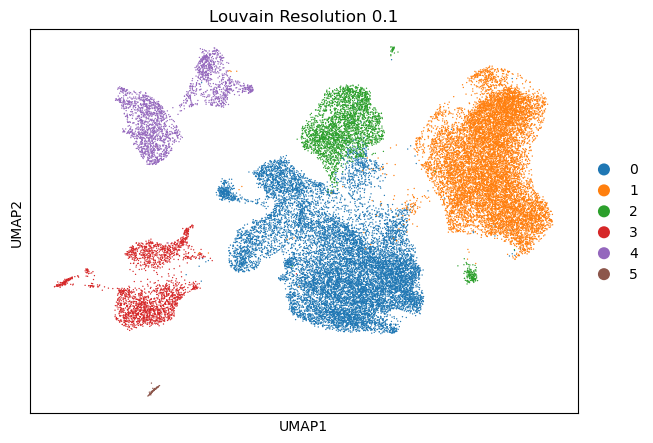

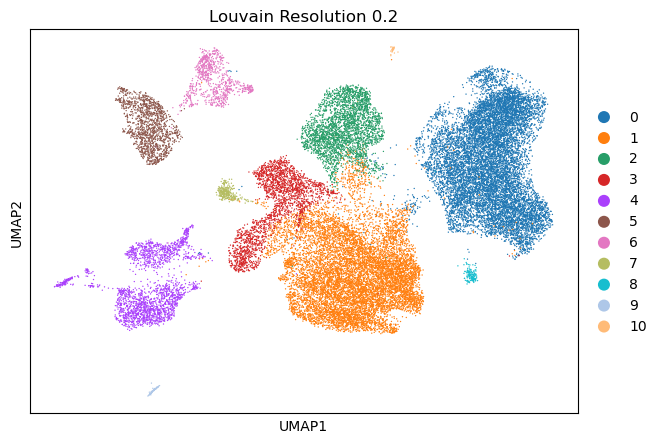

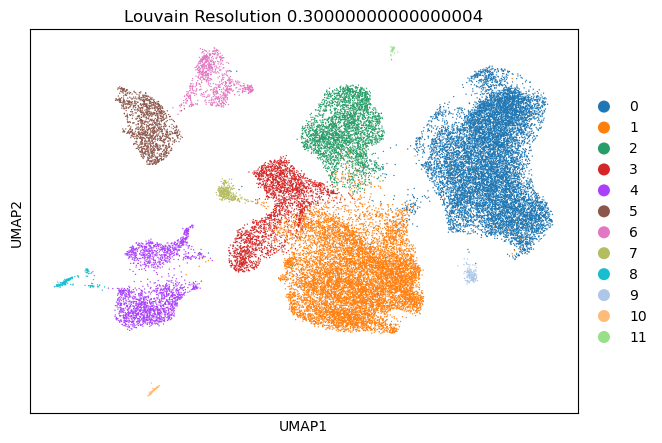

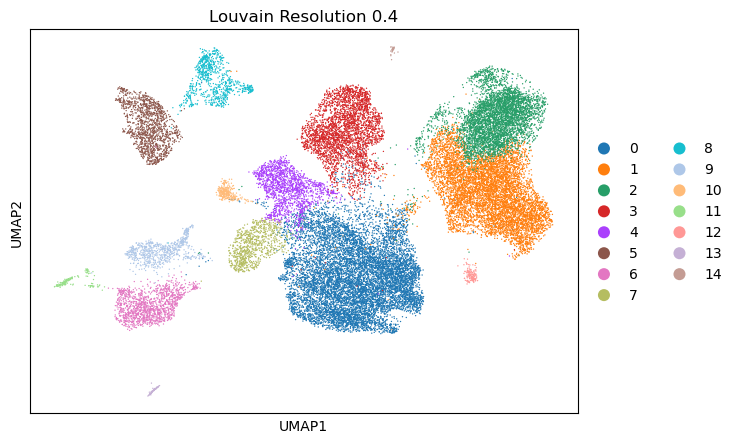

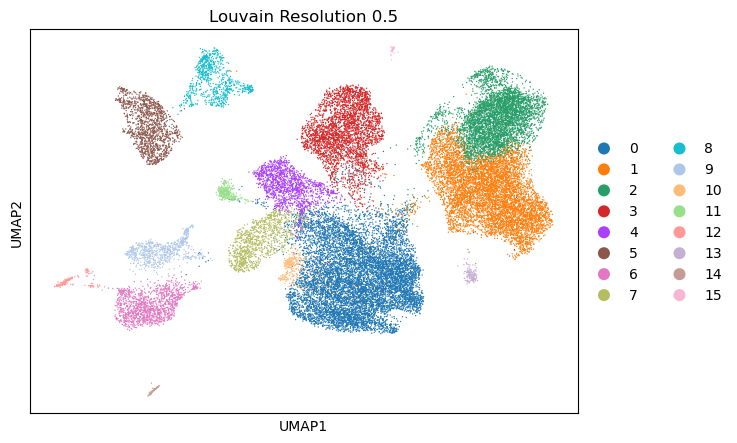

...

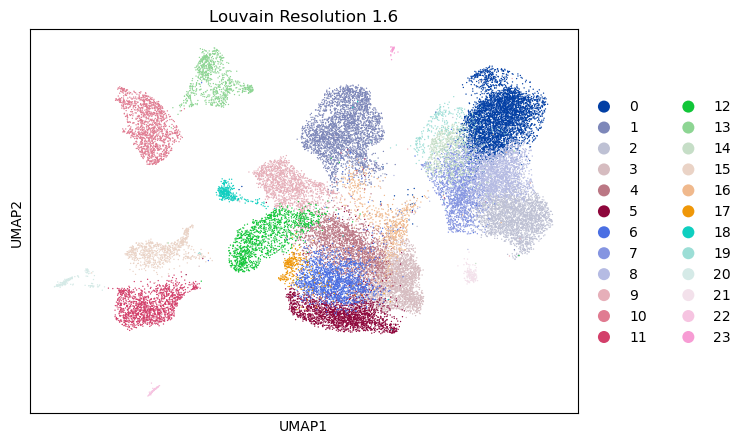

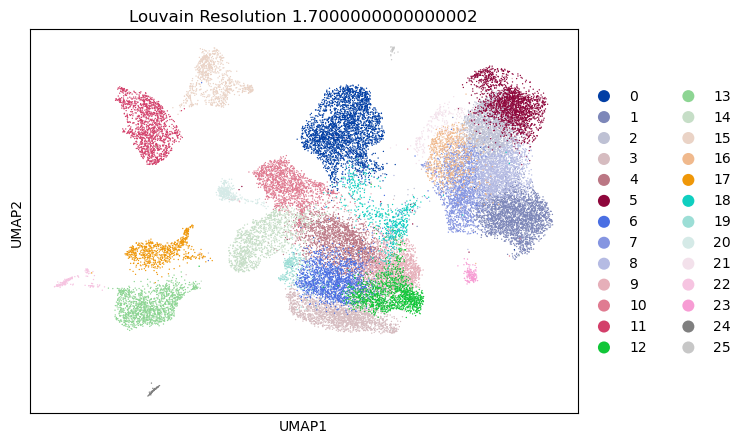

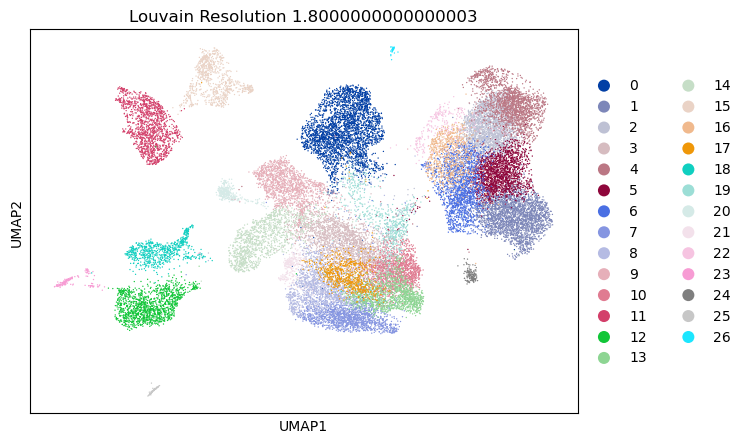

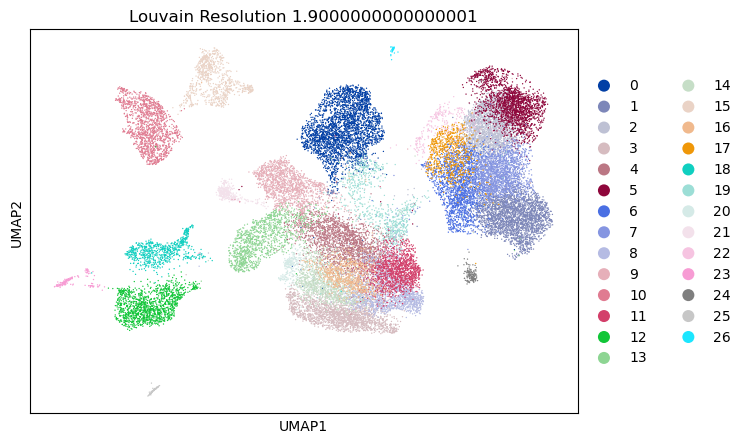

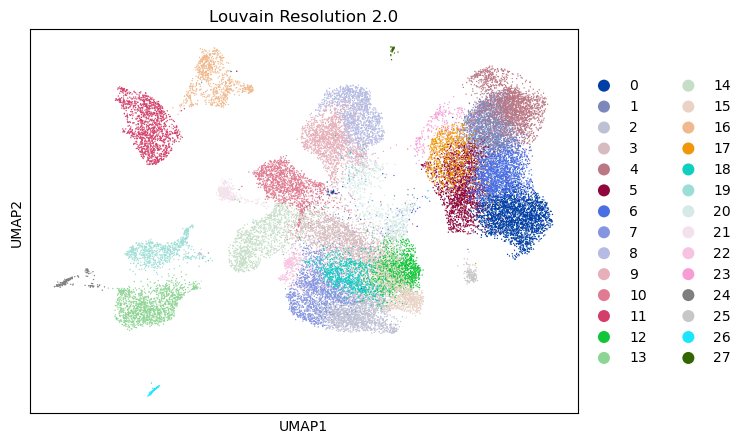

In [ ]:
# Define a range of resolution values
resolutions = np.arange(0.1, 2.1, 0.1)  

# Initialize dictionaries to store scores
silhouette_scores_louvain = {}
davies_bouldin_scores_louvain = {}
calinski_harabasz_scores_louvain = {}

for res in resolutions:
    # Perform Louvain clustering at the given resolution
    sc.tl.louvain(adata, resolution=res, key_added=f'louvain_{res}')

    # Retrieve the cluster labels
    labels = adata.obs[f'louvain_{res}']

    # Assuming adata.obsm['X_pca'] contains the PCA reduced data
    X_pca = adata.obsm['X_pca']

    # Calculate Silhouette Score
    silhouette_scores_louvain[res] = silhouette_score(X_pca, labels)

    # Calculate Davies-Bouldin Score
    davies_bouldin_scores_louvain[res] = davies_bouldin_score(X_pca, labels)

    # Calculate Calinski-Harabasz Score
    calinski_harabasz_scores_louvain[res] = calinski_harabasz_score(X_pca, labels)

    # Plot the clusters
    sc.pl.scatter(adata, basis='umap', color=f'louvain_{res}', title=f'Louvain Resolution {res}')


In [ ]:
# Inspect the scores in the dictionaries
print("Louvain Silhouette Scores:", silhouette_scores_louvain)
print("Louvain Davies-Bouldin Scores:", davies_bouldin_scores_louvain)
print("Louvain Calinski-Harabasz Scores:", calinski_harabasz_scores_louvain)

Louvain Silhouette Scores: {0.1: 0.1313986, 0.2: 0.10635472, 0.30000000000000004: 0.1113339, 0.4: 0.12850803, 0.5: 0.116354086, 0.6: 0.12514238, 0.7000000000000001: 0.1047103, 0.8: 0.10595517, 0.9: 0.10385287, 1.0: 0.10828216, 1.1: 0.08540567, 1.2000000000000002: 0.08155959, 1.3000000000000003: 0.08031953, 1.4000000000000001: 0.08061717, 1.5000000000000002: 0.08502532, 1.6: 0.08943621, 1.7000000000000002: 0.07708883, 1.8000000000000003: 0.076002635, 1.9000000000000001: 0.07655752, 2.0: 0.07889826}
Louvain Davies-Bouldin Scores: {0.1: 1.7358296252668703, 0.2: 1.5559700082735368, 0.30000000000000004: 1.483844380135763, 0.4: 1.5240661681163117, 0.5: 1.544157732218765, 0.6: 1.5637921312373397, 0.7000000000000001: 1.7985311996439282, 0.8: 1.8172831999504915, 0.9: 1.8501128495818542, 1.0: 1.8055587396408206, 1.1: 1.910423189175197, 1.2000000000000002: 1.9878299029970348, 1.3000000000000003: 1.9494196342276209, 1.4000000000000001: 1.9774223204955625, 1.5000000000000002: 2.0078545801717196, 1.

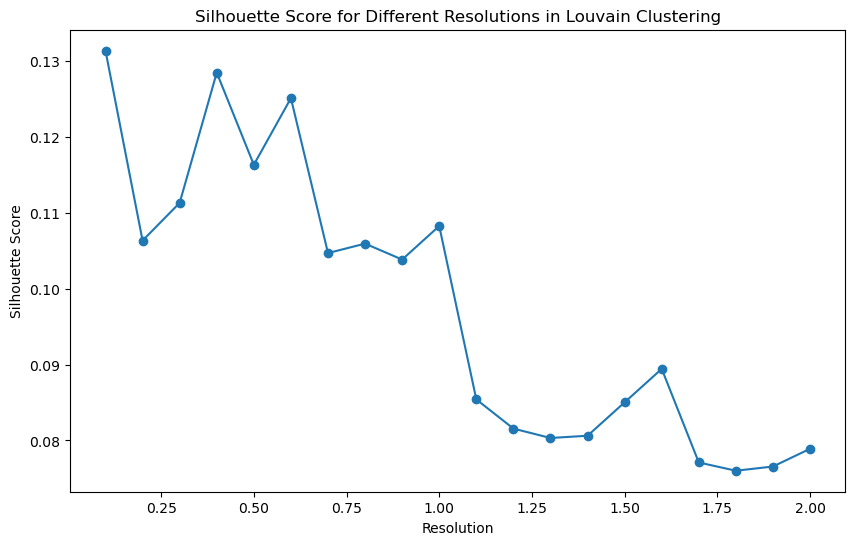

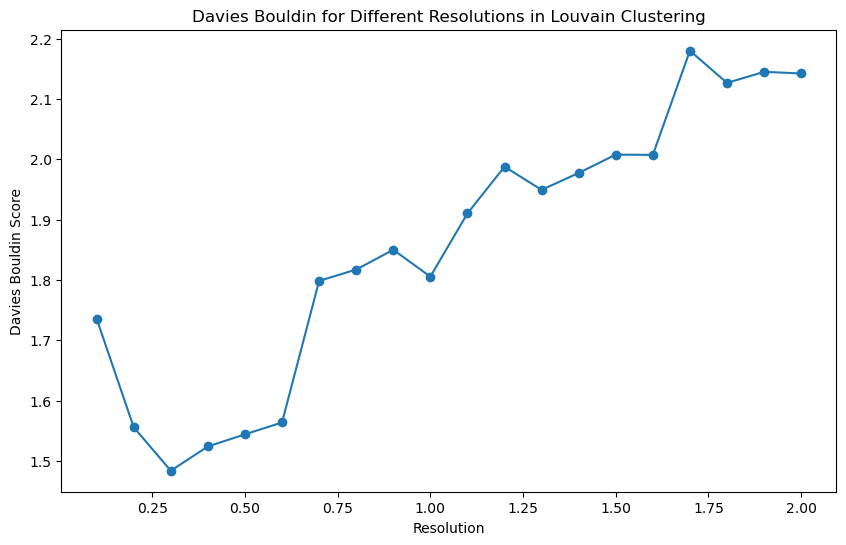

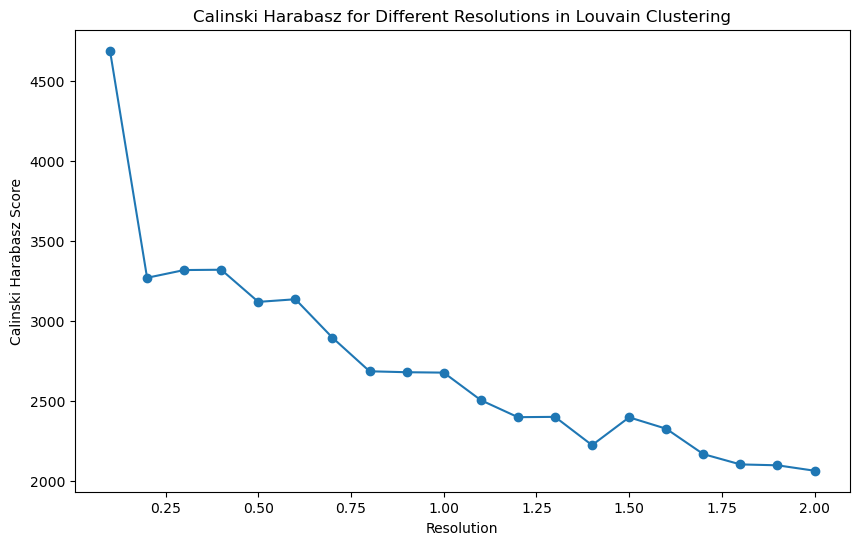

In [ ]:
# Plotting Silhouette Score
plt.figure(figsize=(10, 6))
plt.plot(list(silhouette_scores_louvain.keys()), list(silhouette_scores_louvain.values()), marker='o')
plt.xlabel("Resolution")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score for Different Resolutions in Louvain Clustering")
plt.show()

# Plotting Davies Bouldin Score
plt.figure(figsize=(10, 6))
plt.plot(list(davies_bouldin_scores_louvain.keys()), list(davies_bouldin_scores_louvain.values()), marker='o')
plt.xlabel("Resolution")
plt.ylabel("Davies Bouldin Score")
plt.title("Davies Bouldin for Different Resolutions in Louvain Clustering")
plt.show()

# Plotting Calinski Harabasz Score
plt.figure(figsize=(10, 6))
plt.plot(list(calinski_harabasz_scores_louvain.keys()), list(calinski_harabasz_scores_louvain.values()), marker='o')
plt.xlabel("Resolution")
plt.ylabel("Calinski Harabasz Score")
plt.title("Calinski Harabasz for Different Resolutions in Louvain Clustering")
plt.show()

By visually inspecting the UMAP results above, we can notice that the data is overly clustered when the resolution is equal to or greater than 0.7. Less than the resolution of 0.4, the data does not look to be clustered enough. However, visual inspection can be tricky especially since cluster sizes and distances between clusters may not mean anything in UMAP. Thus, let's evaluate our metrics. We should choose the resolution that balances a high Silhouette Score, a low Davies-Bouldin Score, and a high Calinski-Harabasz Score. This resolution optimally balances the homogeneity within clusters and distinctiveness between different clusters.

The resolution of 0.1 has the highest Silhouette score and Calinski Harabasz Score. However, biological context is very important here. This resolution results in only 5 clusters, even though we expect to see at least around 11 clusters that correspond to the known cell types in pancreatic islet tissues, which are Alpha, Beta, Delta, PP, Epsilon, Ductal, Acinar, Immune, Stellate, Fibroblast, and Endothelial. Some of these cell types even have subtypes. Thus, obtaining only 5 clusters does not make a lot of sense biologically. The reason why this resolution has the highest Silhouette and Calinski Harabasz might be that some of these cell types are very close to each other based on the features here, which are gene expression values. That also potentially explains why the Silhouette scores for all the resolutions are generally low. They are all around 0.1, the Silhouette score gives a value between -1 and 1 where 1 corresponds to the perfect score.

The second-highest Silhouette score and Calinski Harabasz score values correspond to clustering with a resolution of 0.4. Other resolution values away from 0.4 are significantly lower. It also gives us 15 clusters, which makes sense given the biological context. We can notice that the lowest Davies Bouldin Score, and thus best, corresponds to a resolution of 0.3, which is not very different from the score of the resolution of 0.4. On the other hand, while the 0.3 resolution's Calinski Harabasz score is close to that of 0.4, it has a much lower Silhouette Score compared to the 0.4 resolution. 

Therefore, a resolution value of around 0.4 is a good choice given the visual inspection of the UMAPs, the evaluation metrics, and the biological context.

### Leiden Model

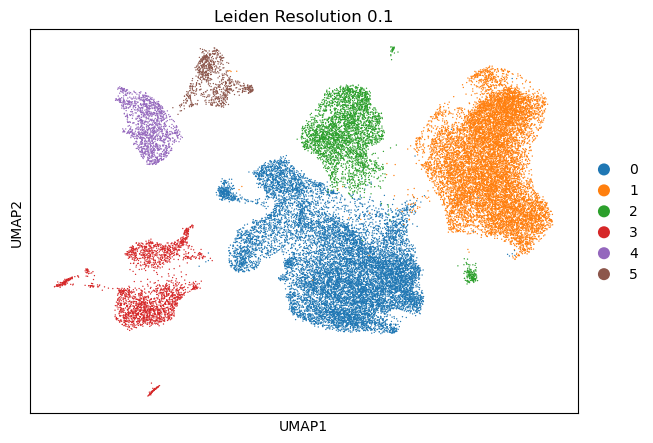

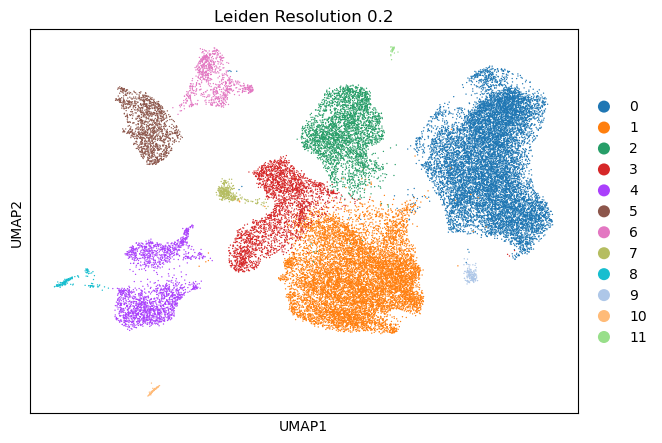

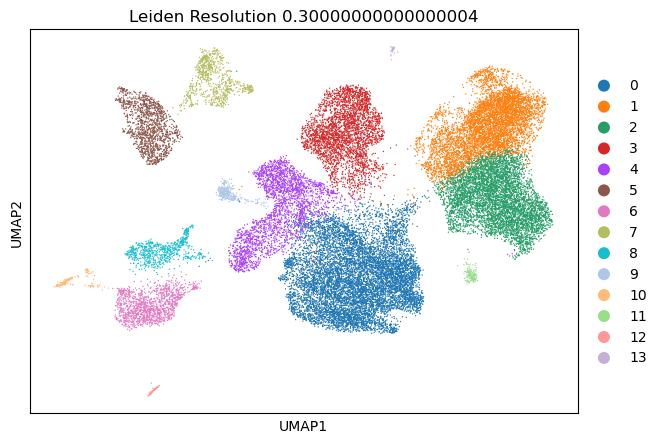

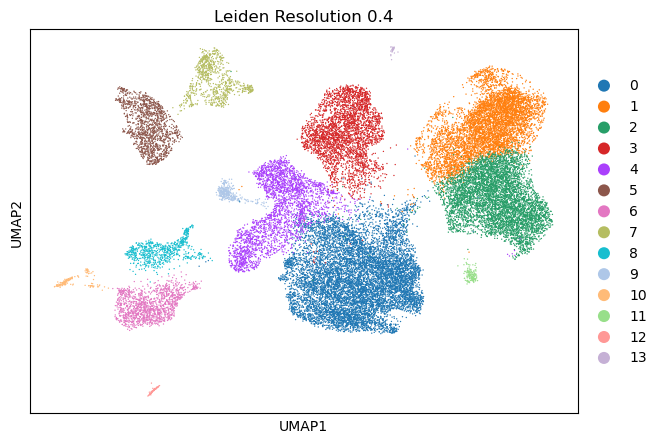

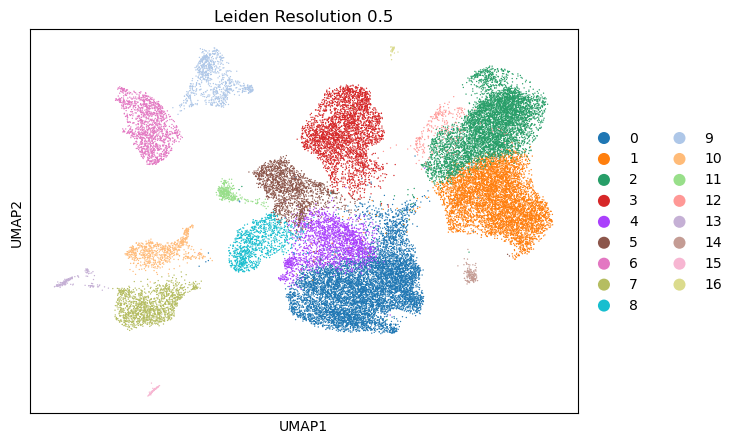

...

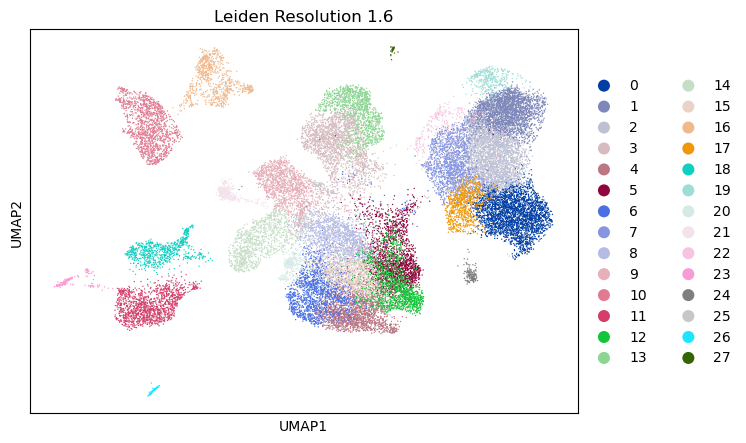

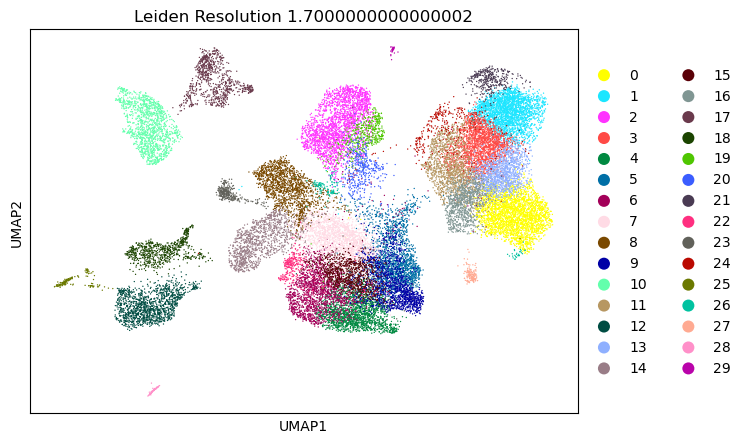

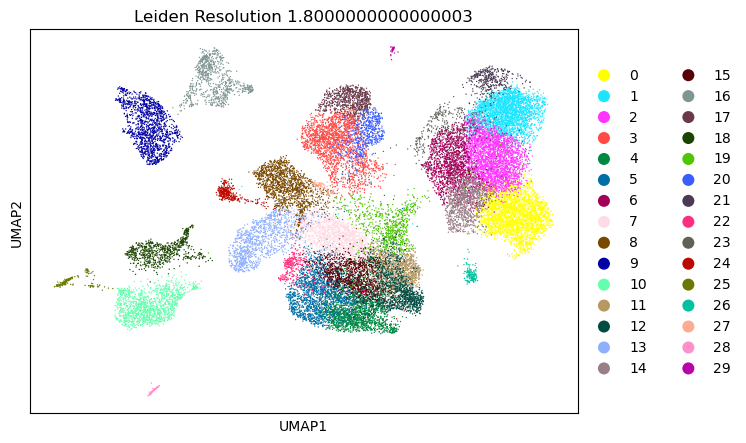

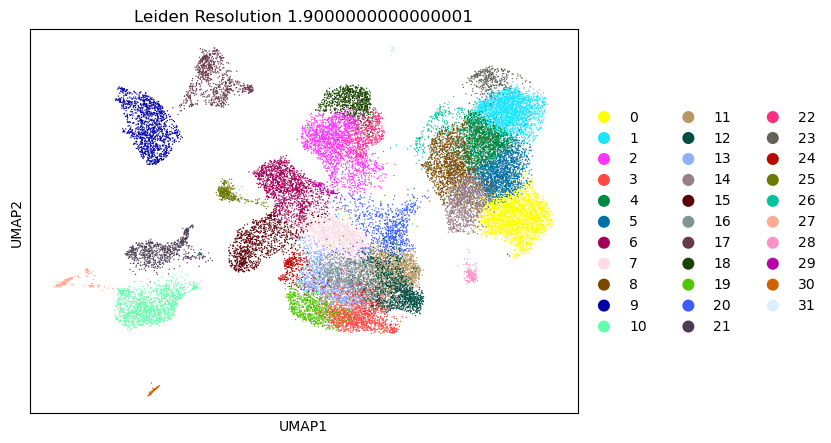

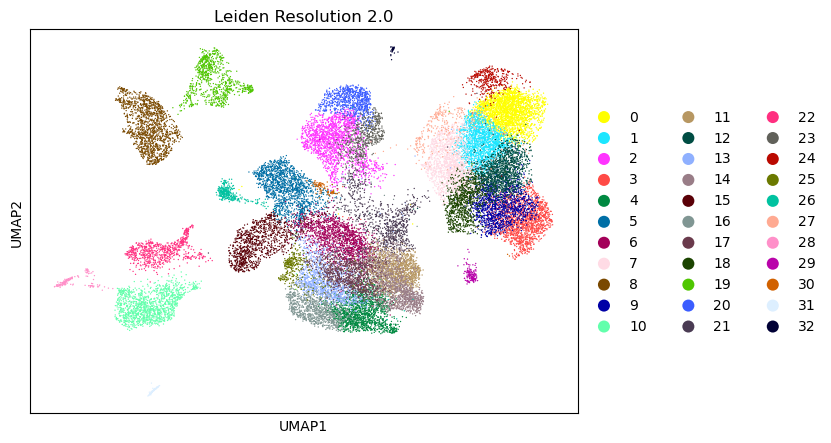

In [ ]:
# Define a range of resolution values
resolutions = np.arange(0.1, 2.1, 0.1)  

# Initialize dictionaries to store scores
silhouette_scores_leiden = {}
davies_bouldin_scores_leiden = {}
calinski_harabasz_scores_leiden = {}

for res in resolutions:
    # Perform Louvain clustering at the given resolution
    sc.tl.leiden(adata, resolution=res, key_added=f'leiden_{res}')

    # Retrieve the cluster labels
    labels = adata.obs[f'leiden_{res}']

    # Assuming adata.obsm['X_pca'] contains the PCA reduced data
    X_pca = adata.obsm['X_pca']

    # Calculate Silhouette Score
    silhouette_scores_leiden[res] = silhouette_score(X_pca, labels)

    # Calculate Davies-Bouldin Score
    davies_bouldin_scores_leiden[res] = davies_bouldin_score(X_pca, labels)

    # Calculate Calinski-Harabasz Score
    calinski_harabasz_scores_leiden[res] = calinski_harabasz_score(X_pca, labels)

    # Plot the clusters
    sc.pl.scatter(adata, basis='umap', color=f'leiden_{res}', title=f'Leiden Resolution {res}')

In [ ]:
# Inspect the scores in the dictionaries
print("Silhouette Scores:", silhouette_scores_leiden)
print("Davies-Bouldin Scores:", davies_bouldin_scores_leiden)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_leiden)

Silhouette Scores: {0.1: 0.14743823, 0.2: 0.11109516, 0.30000000000000004: 0.12193947, 0.4: 0.121766016, 0.5: 0.12185296, 0.6: 0.10912363, 0.7000000000000001: 0.108099416, 0.8: 0.10685251, 0.9: 0.10824808, 1.0: 0.0959738, 1.1: 0.09072955, 1.2000000000000002: 0.09268919, 1.3000000000000003: 0.08944394, 1.4000000000000001: 0.08263506, 1.5000000000000002: 0.07802461, 1.6: 0.08744178, 1.7000000000000002: 0.08121817, 1.8000000000000003: 0.08364834, 1.9000000000000001: 0.07926392, 2.0: 0.08137741}
Davies-Bouldin Scores: {0.1: 1.688165650169185, 0.2: 1.4809422444624107, 0.30000000000000004: 1.5681915864413984, 0.4: 1.5686949304906155, 0.5: 1.6511103252470996, 0.6: 1.7447416939036786, 0.7000000000000001: 1.749949032673175, 0.8: 1.7843983830247823, 0.9: 1.8359917649296893, 1.0: 1.9082639505053467, 1.1: 1.909857046799343, 1.2000000000000002: 1.9733934872037437, 1.3000000000000003: 1.9580650709851153, 1.4000000000000001: 1.9502978491237701, 1.5000000000000002: 2.01220210694947, 1.6: 1.97837701426

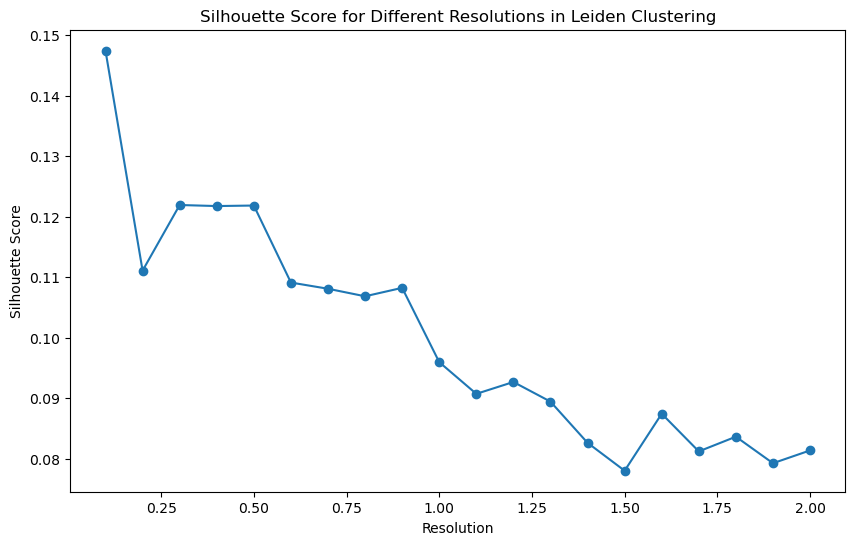

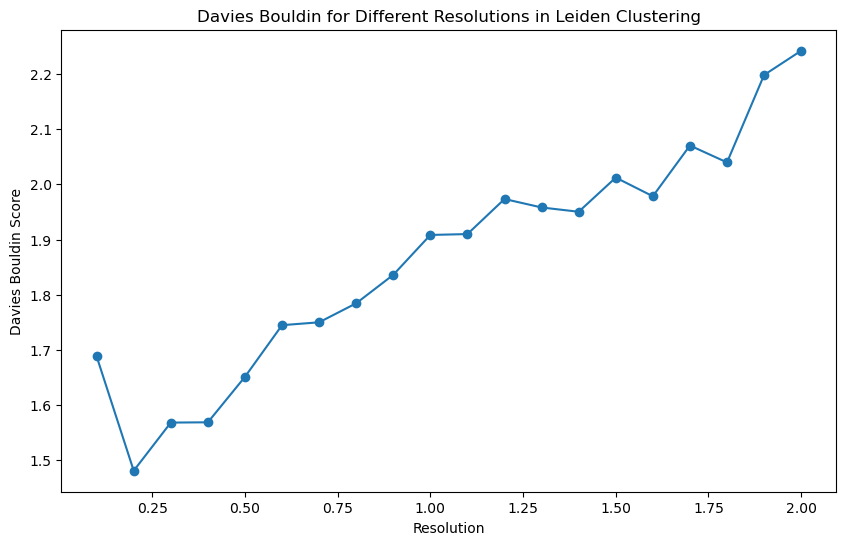

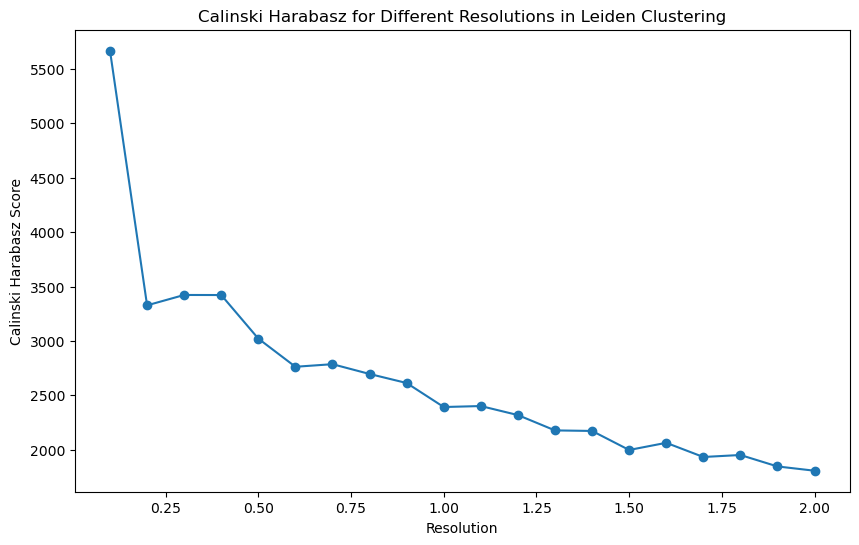

In [ ]:
# Plotting Silhouette Score
plt.figure(figsize=(10, 6))
plt.plot(list(silhouette_scores_leiden.keys()), list(silhouette_scores_leiden.values()), marker='o')
plt.xlabel("Resolution")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score for Different Resolutions in Leiden Clustering")
plt.show()

# Plotting Davies Bouldin Score
plt.figure(figsize=(10, 6))
plt.plot(list(davies_bouldin_scores_leiden.keys()), list(davies_bouldin_scores_leiden.values()), marker='o')
plt.xlabel("Resolution")
plt.ylabel("Davies Bouldin Score")
plt.title("Davies Bouldin for Different Resolutions in Leiden Clustering")
plt.show()

# Plotting Calinski Harabasz Score
plt.figure(figsize=(10, 6))
plt.plot(list(calinski_harabasz_scores_leiden.keys()), list(calinski_harabasz_scores_leiden.values()), marker='o')
plt.xlabel("Resolution")
plt.ylabel("Calinski Harabasz Score")
plt.title("Calinski Harabasz for Different Resolutions in Leiden Clustering")
plt.show()

Similar to Louvain, I started with visually inspecting the UMAP visualizations for Leiden above. We can also notice that the data is overly clustered starting at a resolution of around 0.6 and it does not look clustered enough when the resolution is less than 0.3. However, as discussed earlier, visual inspection can be tricky because cluster sizes and distances among clusters might not mean anything in UMAP. Thus, similar to Louvain, I evaluated the performance metrics to choose the resolution for Leiden that balances a high Silhouette Score, a low Davies-Bouldin Score, and a high Calinski-Harabasz Score. This resolution optimally balances the homogeneity within clusters and distinctiveness between different clusters.

The resolution of 0.1 has the highest Silhouette score and Calinski Harabasz Score, which resulted in only 5 clusters, similar to Louvain. Since the biological context is important as I discussed in detail earlier, I discarded this resolution as I did with Louvain. I also explained earlier why might it be the case that the scores are high at this resolution for this case. Additionally, the lowest (best) Davies Bouldin Scores correspond to Leiden clustering with a resolution of 0.2, which I discarded for the same reasoning.

The second-best Silhouette score, Davies Bouldin Score, and Calinski Harabasz score values correspond to clustering with resolutions of 0.3 and 0.4, which have almost identical results. They both result in 14 clusters. I proceeded with 0.4 since it is also the same value I chose for Louvain. Therefore, a resolution value of around 0.4 is a good choice given the visual inspection of the UMAPs, the performance metrics, and the biological context.

<a id='72'></a>
## 7.2. Performance Metrics Evaluation and Comparison: Louvain Outperforms Slightly

### Louvain Model

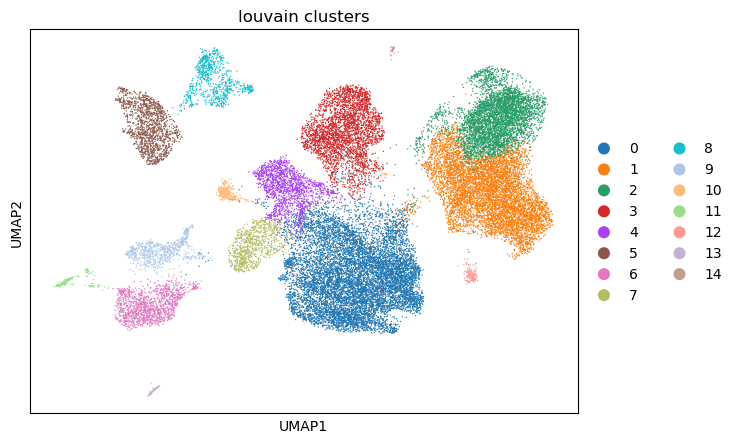

Silhouette score:  0.12850803
Davies Bouldin score:  1.5240661681163117
Calinski Harabasz score:  3319.0246984689684


In [ ]:
sc.tl.louvain(adata, key_added= 'louvain_clusters', resolution=0.4)
sc.pl.scatter(adata, basis='umap', color=['louvain_clusters'])

labels = adata.obs['louvain_clusters']
X_pca = adata.obsm['X_pca']

# Calculate Silhouette Score
silhouette_score_value_louvain = silhouette_score(X_pca, labels)
print("Silhouette score: ", silhouette_score_value_louvain)

# Calculate Davies-Bouldin Score
davies_bouldin_score_value_louvain = davies_bouldin_score(X_pca, labels)
print("Davies Bouldin score: ",  davies_bouldin_score_value_louvain)

# Calculate Calinski-Harabasz Score
calinski_harabasz_score_value_louvain = calinski_harabasz_score(X_pca, labels)
print("Calinski Harabasz score: ", calinski_harabasz_score_value_louvain)

### Leiden Model

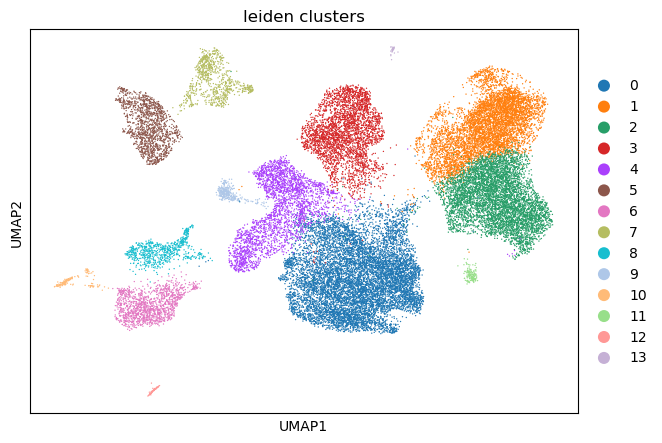

Silhouette score:  0.121766016
Davies Bouldin score:  1.5686949304906155
Calinski Harabasz score:  3421.921284307654


In [ ]:
sc.tl.leiden(adata, key_added= 'leiden_clusters', resolution=0.4)
sc.pl.scatter(adata, basis='umap', color=['leiden_clusters'])

labels = adata.obs['leiden_clusters']
X_pca = adata.obsm['X_pca']

# Calculate Silhouette Score
silhouette_score_value_leiden = silhouette_score(X_pca, labels)
print("Silhouette score: ", silhouette_score_value_leiden)

# Calculate Davies-Bouldin Score
davies_bouldin_score_value_leiden = davies_bouldin_score(X_pca, labels)
print("Davies Bouldin score: ",  davies_bouldin_score_value_leiden)

# Calculate Calinski-Harabasz Score
calinski_harabasz_score_value_leiden = calinski_harabasz_score(X_pca, labels)
print("Calinski Harabasz score: ", calinski_harabasz_score_value_leiden)

### Comparison Results

I inspected the UMAP visualizations, the performance metrics, the number of clusters, and the biological context to compare the Louvain model with the Leiden model. The UMAP visualizations of both models look very similar as they have similar separations between clusters. However, the Leiden model's separations look a little cleaner and more distinct compared to Louvain's among the large clusters on the right side. They both have almost identical performance metrics. Louvain does slightly better at the Silhouette and Davies Bouldin scores, while Leiden does slightly better at Calinski Harabasz score. Therefore, given the definition of each of the scores I discussed earlier, Louvain does slightly better at having better compactness and separation of clusters in terms of similarity, while Leiden does slightly better at the global distribution of clusters, which we can see from the UMAP visualizations. 

Thus, this is a tough choice between the two, especially that they provide different numbers of clusters, 15 for Louvain versus 14 for Leiden. We need to use the biological context here because, ultimately, it is the most important. If we look back at the UMAP visualizations, specifically at the purple cluster (4) in the Leiden UMAP, it is split into two clusters in the Louvain's UMAP. Later in the "Gene Markers and Cell Typing Analysis and Visualization" section, I discuss that Beta cells correspond to the region of the UMAP visualization that includes this cluster and that Beta cells are composed of 4 different subtypes. In the Leiden case, it only identified 3 subtypes as it considered two different subtypes as one subtype, while Louvain accurately identified 4 distinct clusters that correspond to the 4 subtypes of Beta cells. 

Therefore, I believe that Louvain slightly outperforms Leiden in this particular context even though Leiden is generally improved over Louvain as I discussed in the previous section. This is also surprising because Leiden is expected to generally produce more granular (or a higher number of) clusters due to its refinement step, while in this case, it detected less with the same resolution. There is no definite reason why Louvain outperformed slightly and it might be just randomness especially since the performance metrics are almost identical. One possibility is that the refinement step in Leiden, designed to ensure connected communities, might lead to the merging of smaller clusters that Louvain would otherwise identify as separate. This is because Leiden focuses on strengthening the internal connectivity of clusters. The subtypes of Beta cells likely have very similar features and are hard to differentiate. That can also be because of the structure of the dataset itself which could be more suited to the way Louvain partitions the data. Certain datasets with particular structures or noise patterns might be partitioned into more clusters by Louvain. In conclusion, I chose to proceed with the Louvain model for the rest of the analysis.

<a id='73'></a>
## 7.3 Evaluating Model's Robustness on Data Subsets

After I chose the Louvain model, I wanted to make sure that the model is consistent and stable. To evaluate the model's robustness, I ran it on subsets of the dataset that I obtained using stratified sampling as explained in detail earlier. I compared the resulting clustering and performance metrics between these subsets and the original data at the same resolution of 0.4. 


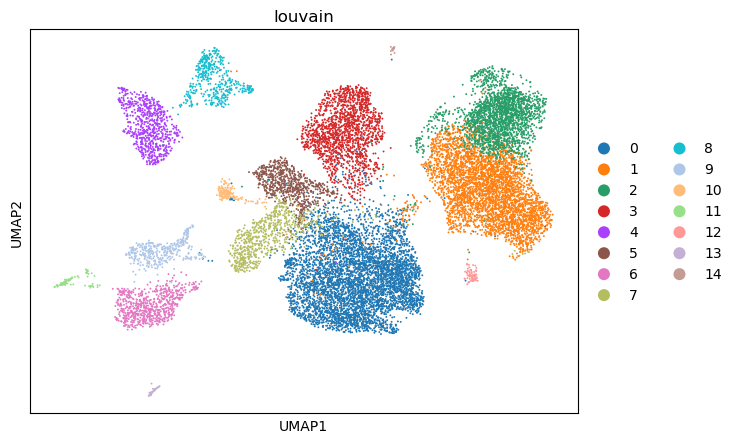

First Subset's Silhouette score:  0.12061625
First Subset's Davies Bouldin score:  1.5584084794024882
First Subset's Calinski Harabasz score:  1641.2112768128784


In [ ]:
# First subset:

sc.tl.louvain(first_subset_adata, resolution=0.4)
sc.pl.scatter(first_subset_adata, basis='umap', color=['louvain'])

labels_first_subset = first_subset_adata.obs['louvain']
X_pca_first_subset = first_subset_adata.obsm['X_pca']

# Calculate Silhouette Score
first_subset_silhouette_score = silhouette_score(X_pca_first_subset, labels_first_subset)
print("First Subset's Silhouette score: ", first_subset_silhouette_score)

# Calculate Davies-Bouldin Score
first_subset_davies_bouldin_score = davies_bouldin_score(X_pca_first_subset, labels_first_subset)
print("First Subset's Davies Bouldin score: ",  first_subset_davies_bouldin_score)

# Calculate Calinski-Harabasz Score
first_subset_calinski_harabasz_score = calinski_harabasz_score(X_pca_first_subset, labels_first_subset)
print("First Subset's Calinski Harabasz score: ", first_subset_calinski_harabasz_score)

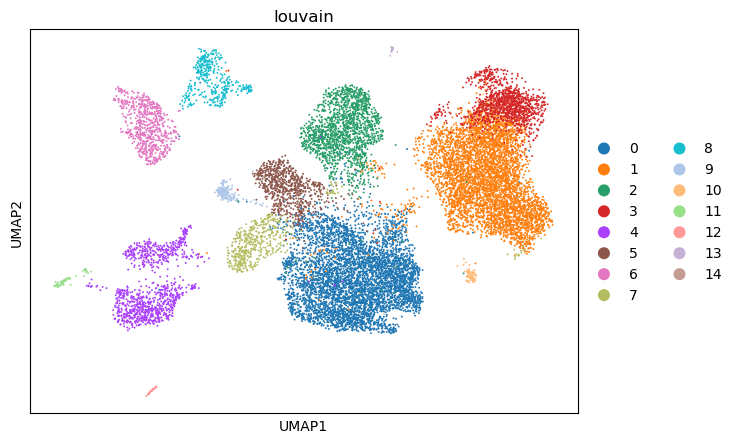

Second Subset's Silhouette score:  0.0985045
Second Subset's Davies Bouldin score:  1.435328142048782
Second Subset's Calinski Harabasz score:  1422.7236982253712


In [ ]:
# Second subset:

sc.tl.louvain(second_subset_adata, resolution=0.4)
sc.pl.scatter(second_subset_adata, basis='umap', color=['louvain'])

labels_second_subset = second_subset_adata.obs['louvain']
X_pca_second_subset = second_subset_adata.obsm['X_pca']

# Calculate Silhouette Score
second_subset_silhouette_score = silhouette_score(X_pca_second_subset, labels_second_subset)
print("Second Subset's Silhouette score: ", second_subset_silhouette_score)

# Calculate Davies-Bouldin Score
second_subset_davies_bouldin_score = davies_bouldin_score(X_pca_second_subset, labels_second_subset)
print("Second Subset's Davies Bouldin score: ",  second_subset_davies_bouldin_score)

# Calculate Calinski-Harabasz Score
second_subset_calinski_harabasz_score = calinski_harabasz_score(X_pca_second_subset, labels_second_subset)
print("Second Subset's Calinski Harabasz score: ", second_subset_calinski_harabasz_score)

From these results, we can notice the following:

Cluster Variations:

The original dataset and both subsets have 15 clusters. The first subset has the same clusters as the original dataset. However, the second subset has one different cluster. Particularly, the cluster with ID 14 in the second subset does not look obvious in the visualization as a group. In the cell type analysis in the next section, this small cluster does not correspond to a real biological cell type. This might be due to the model overfitting some patterns in this very small amount of data in the subset due to the subset's smaller sample size. Additionaly, the cluster with ID 4 in the second subset is split into two different clusters (with IDs 6 and 9) in the original dataset. Notably, these two clusters correspond to two very similar but distinct cell types, Stellate and Fibroblast, according to the cell type analysis in the next section. The similarity between the two cell types in their gene expression profiles could have made it harder for the model to differentiate them with a smaller sample size. This variation in clusters suggests some level of sensitivity in the Louvain model to the dataset's size or composition.

Performance metrics:

1- The original dataset has a Silhouette score of 0.1285, indicating moderate separation between clusters. The first subset has a slightly lower score (0.1206), suggesting a slight decrease in cluster separation and compactness in the subsets. However, the scores are still in a comparable range, indicating that the overall cluster structure is maintained. On the other hand, the second subset has a noticeable decrease in its Silhouette score (0.0985), which aligns with the cluster variations I discussed above.

2- The original dataset's Davies-Bouldin score is 1.524, where lower values indicate better clustering. The first subset has a slightly higher score of 1.582, suggesting a minor increase in within-cluster dispersion or a decrease in between-cluster separation. Surprisingly, the second subset has a slightly lower, and thus better, score of 1.435, suggesting a minor decrease in within-cluster dispersion or an increase in between-cluster separation. This can be explained by the second subset not differentiating between two very similar cell types, Stellate and Fibroblast. In general, the scores for both subsets and the original dataset are close enough to suggest that the clustering quality is relatively stable.

3- The original dataset's Calinski-Harabasz score is significantly higher (3319.02) compared to the subsets (1641.21 and 1422.72). This substantial difference indicates that the variance ratio is more favorable in the original dataset, likely due to the larger sample size contributing to a clearer definition of clusters.

Therefore, we can conclude that the model has a reasonable level of consistency and robustness across the original dataset and the stratified subsets, as indicated by similar trends in the clustering performance metrics. The variations in clusters in the second subset and these metrics, especially the Calinski-Harabasz score and the Silhouette score for the second subset, are likely due to the decrease in the sample size.

<a id='8'></a>
# 8. Gene Markers and Cell Typing Analysis and Visualization

<a id='81'></a>
## 8.1. Gene Markers Characterization in Clusters

After clustering the scRNA-seq data of human pancreatic islets, I wanted to identify the cell type for each of these clusters. To do so, I used marker genes or Cell-type-specific (CTS) genes. These genes are highly expressed in one cell type but lowly expressed in other types. Thus, they define cellular identity. Again, the biological context is very important here. Pancreatic islet datasets typically have the following cell types: Alpha, Beta, Delta, PP, Epsilon, Ductal, Acinar, Immune, Stellate, Fibroblast, and Endothelial. We should be able to find those cell types in our clusters.

First, I started with using Scanpy's $tl.rank-genes-groups$ function, which identifies all ranks genes for the identified Louvain clusters using a t-test. It helps in identifying genes that are significantly differentially expressed across clusters. I then plotted these top-ranked genes for each cluster using the $pl.rank-genes-groups$ function.

Second, I had a list of important marker genes that are specific for each of the pancreatic islet cell types. These are as follows:
- 'Alpha': 'GCG'
- 'Beta': 'INS'
- 'Delta': 'SST'
- 'PP': 'PPY'
- 'Epsilon': 'GHRL'
- 'Ductal': 'KRT19'
- 'Acinar': 'PRSS1'
- 'Immune': 'PTPRC'
- 'Stellate': 'COL1A1', 'PDGFRB'
- 'Fibroblast': 'COL1A1', 'PDGFRA'
- 'Endothelial': 'PLVAP'

We can notice that gene known marker genes are present in the different plots we produced above. However, their presence varies greatly among these cluster plots, indicating the presence of different cell types. 

I visualized the expression of these specific gene markers on the UMAP projection. Each plot focuses on one gene known to be characteristic of particular cell types. For example, 'INS' for Beta cells, 'GCG' for Alpha cells, etc. This helps to visualize which clusters or regions in the UMAP are enriched for these marker genes, and whether this enrichment is specific and confined to these clusters. Since this is indeed the case here, this helps prove that the clustering process I performed was indeed effective. We can already start to tell the corresponding cell type for each cluster using this information. After that I created a dot-plot visualization that combines gene expression data for these specific markers of cell types with clustering information, helping to correlate specific gene markers with identified clusters. We can easily identify which cluster corresponds to which cell type using this plot.

Finally, I used this information to annotate the clusters with their corresponding clusters and visualize this annotation on a UMAP plot.

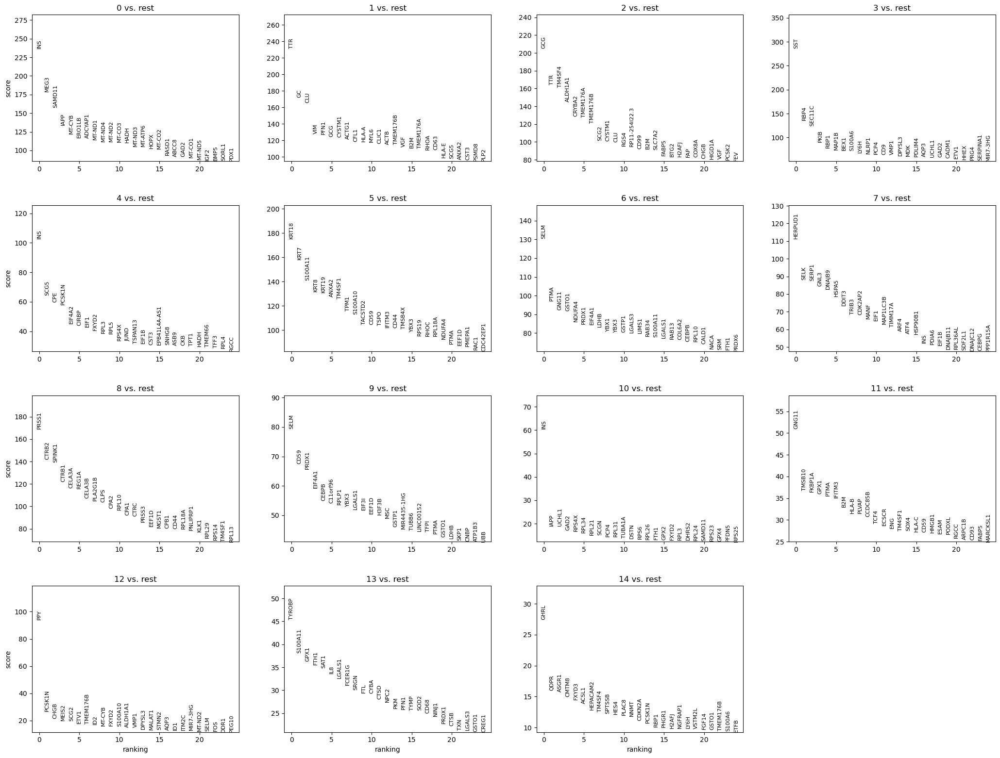

In [ ]:
# Identifying significantly enriched genes in each cluster
sc.tl.rank_genes_groups(adata, 'louvain_clusters', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

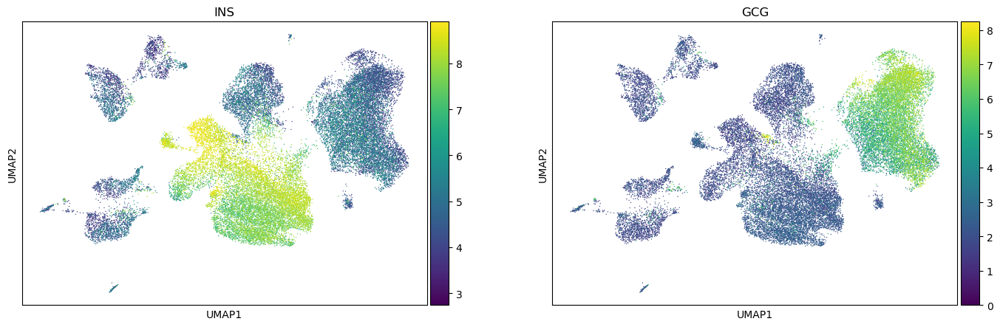

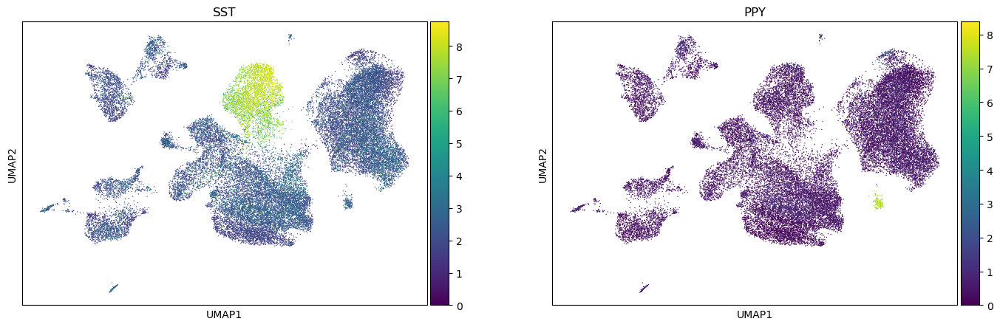

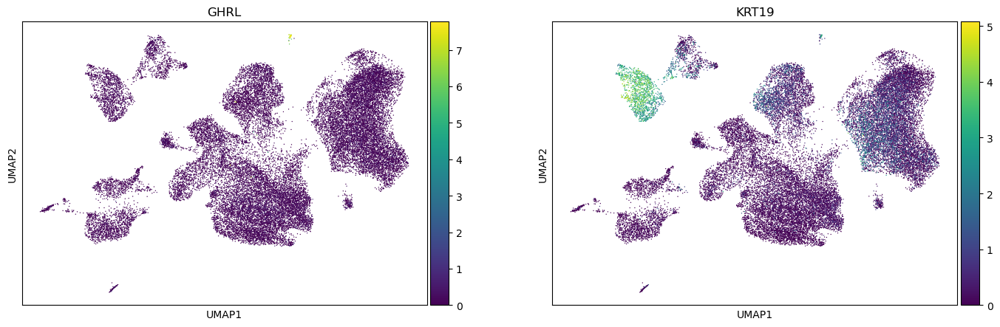

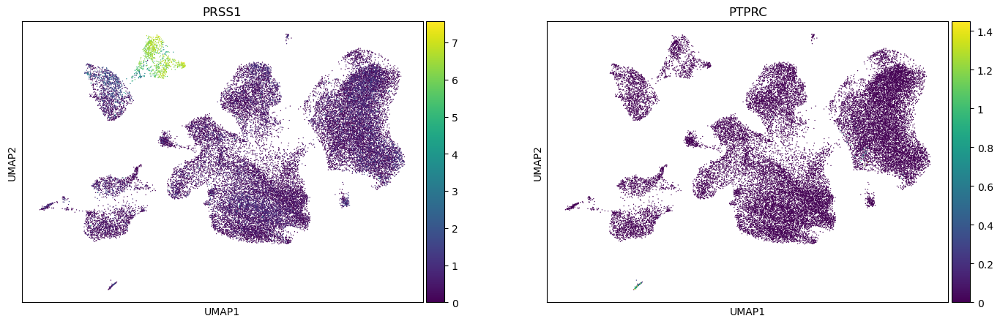

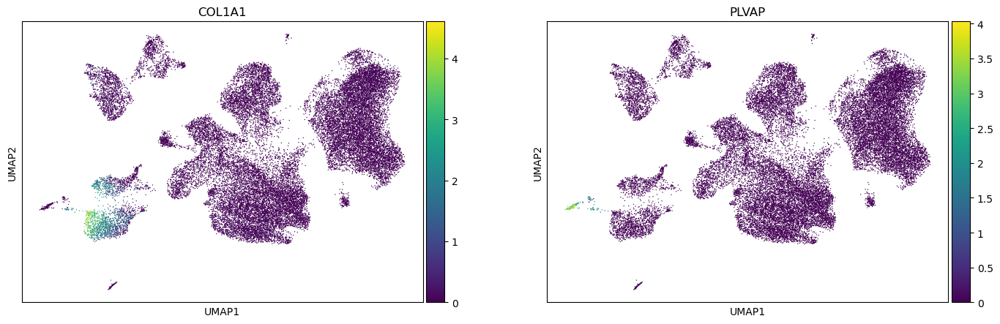

In [ ]:
# Visualizing the expression of specific marker genes known for pancreatic islets cell types
sc.pl.scatter(adata, basis='umap', color=['INS', 'GCG'])
sc.pl.scatter(adata, basis='umap', color=['SST', 'PPY'])
sc.pl.scatter(adata, basis='umap', color=['GHRL', 'KRT19'])
sc.pl.scatter(adata, basis='umap', color=[ 'PRSS1', 'PTPRC'])
sc.pl.scatter(adata, basis='umap', color=['COL1A1', 'PLVAP'])

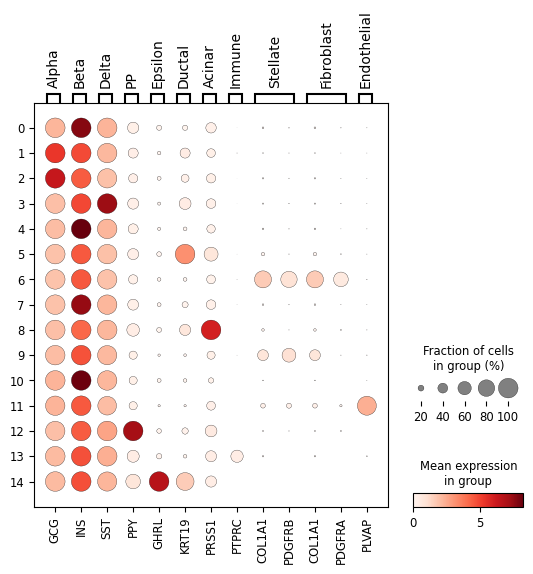

In [ ]:
# Marker genes to cell type dictionary
marker_genes_dict = {
    'Alpha': ['GCG'],
    'Beta': ['INS'],
    'Delta': ['SST'],
    'PP': ['PPY'],
    'Epsilon': ['GHRL'],
    'Ductal': ['KRT19'],
    'Acinar': ['PRSS1'],
    'Immune': ['PTPRC'],
    'Stellate': ['COL1A1', 'PDGFRB'],
    'Fibroblast': ['COL1A1', 'PDGFRA'],
    'Endothelial': ['PLVAP']
}

# Dotplot for visualization that combines gene expression data for these specific markers of cell types
# with clustering information
sc.pl.dotplot(adata, marker_genes_dict, 'louvain_clusters')

<a id='82'></a>
## 8.2. Clusters Cell Type Annotations

In [ ]:
# Using the previous information to annotate cell types

map_names = {}

for c in adata.obs['louvain_clusters'].cat.categories:
    if c in ['0','4', '10', '7']:
        map_names[c] = 'Beta'
    elif c in ['1', '2']:
        map_names[c] = 'Alpha'  
    elif c in ['3']:
        map_names[c] = 'Delta'
    elif c in ['12']:
        map_names[c] = 'PP'    
    elif c in ['14']:
        map_names[c] = 'Epsilon'
    elif c in ['5']:
        map_names[c] = 'Ductal'
    elif c in ['8']:
        map_names[c] = 'Acinar'
    elif c in ['13']:
        map_names[c] = 'Immune'     
    elif c in ['9']:
        map_names[c] = 'Stellate'
    elif c in ['6']:
        map_names[c] = 'Fibroblast'
    elif c in ['11']:
        map_names[c] = 'Endothelial' 
    else:
        map_names[c] = c

adata.obs['clusters_annotations'] = adata.obs['louvain_clusters']
adata.obs['clusters_annotations'] = adata.obs['clusters_annotations'].map(map_names).astype('category')
adata.obs['Cell_Type'] = adata.obs['clusters_annotations'].cat.reorder_categories(
    ['Alpha', 'Beta', 'Delta', 'PP', 'Epsilon','Ductal', 'Acinar', 'Immune', 'Stellate', 'Fibroblast','Endothelial'])

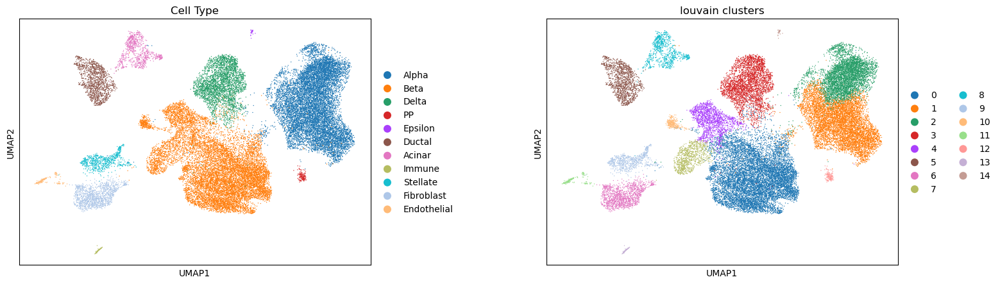

In [ ]:
# Visualizing cell types and clusters on the UMAP
sc.pl.scatter(adata, basis='umap', color=['Cell_Type', 'louvain_clusters'])

### Conclusion

The visualization on the left shows a clear separation of cell types across the UMAP dimensions, indicating that the clustering algorithm has successfully distinguished different biological cell types based on their gene expression profiles. The distinct clusters align well with known cell type markers, demonstrating the biological relevance of the clustering results. On the right, the Louvain clustering algorithm's results are displayed, revealing distinct groupings.

Notably, it could identify cell types that are often hard to segregate because they are very rare in pancreatic islets, such as Epsilon cells. These rare islet cells were detected in the original data and in both subsets. Also, the amount of data in each cluster corresponds to the ratio between different types of cells in pancreatic islets, which is 30% glucagon-producing α-cells, 60% insulin-producing β-cells, with the remainder 10% made up of δ-cells (somatostatin-producing), γ- or PP cells (pancreatic polypeptide-producing), and ε-cells (ghrelin-producing), not including other cell types that are not islets themselves but distributed within the pancreatic islets like Ductal, Acinar, Immune, Endothelial, Stellate, and Fibroblast (Da Silva Xavier, 2018). 

Interestingly, the region corresponding to Beta cells comprises four distinct clusters in the Louvain results, aligning with recent research from 2016 that identified four subtypes within Beta cells, challenging the previous belief that they represented a single cell type (Dorrell et al., 2016). The model also accurately identified two subtypes of Alpha cells. That shows that my analysis was finely tuned to detect subtle distinctions among cell types. However, one of the two stratified subsets of the data I evaluated earlier struggled to separate Stellate cells from Fibroblasts, which is understandable given their similar markers and gene expression profiles. Also, the Leiden model had difficulties distinguishing one of the four Beta cell subtypes. 

Therefore, the Louvain model excels at distinguishing different cell types and subtypes based on gene expression profiles, as evidenced by the visually distinct clusters in the clusters UMAP visualization and the clean UMAP visualization of marker gene expression. However, it is crucial to have a sufficient amount of data to ensure robust classification.

<a id='9'></a>
# 9. Executive Summary

#### Overview
This paper outlines a comprehensive computational pipeline to analyze single-cell RNA sequencing (scRNA-seq) data for human pancreatic islets obtained from 5 donors, aiming to cluster cells based on gene expression profiles and identify cell types using marker genes. The work aligns with my academic pursuits and passion in genomics and bioinformatics, with a specific focus on enhancing the scHAMR pipeline I developed during a previous internship and building upon it for my capstone.

#### Methodology
The pipeline is meticulously structured into several sections, each addressing a critical aspect of scRNA-seq data analysis:

1- **Quality Control and Preprocessing**: I employed rigorous quality control measures to filter out low-quality cells. Subsequently, I normalized and logarithmized the data, ensuring consistency across cells for subsequent analyses.

2- **Feature Engineering and Dimensionality Reduction**: I identified highly variable genes, and applied Principal Component Analysis (PCA) to linearly reduce dimensionality while preserving the most significant variance in the data. I calculated the neighborhood graph, laying the groundwork for clustering and visualization algorithms that require an understanding of cell relationships. I also employed Uniform Manifold Approximation and Projection (UMAP) for non-linear dimensionality reduction, projecting data onto a two-dimensional space conducive to visual interpretation while preserving local and global structures.

3- **Batch Correction**: I utilized the ComBat method to correct batch effects among the samples, a critical step to ensure that the biological conclusions drawn from the data are not confounded by technical artifacts.

4- **Clustering Models and Fine-Tuning**: I selected the Louvain model and the Leiden model for clustering due to their efficiency and effectiveness in uncovering biological heterogeneity. I fine-tuned their resolution parameter based on performance metrics.

5- **Models Evaluation and Validation**: I evaluated and compared the two clustering models using visual inspection, performance metrics, such as the Silhouette Score, Davies-Bouldin Score, and Calinski-Harabasz Score, and more importantly, the biological context. Based on this, I chose to proceed with the Louvain model. I then assessed the robustness of the Louvain model by applying the same clustering process to stratified subsets of the original data and comparing the outcomes.

6- **Cell Type Identification**: Marker genes were then used to annotate the identified clusters with corresponding cell types.

The results of this pipeline are visualized below.

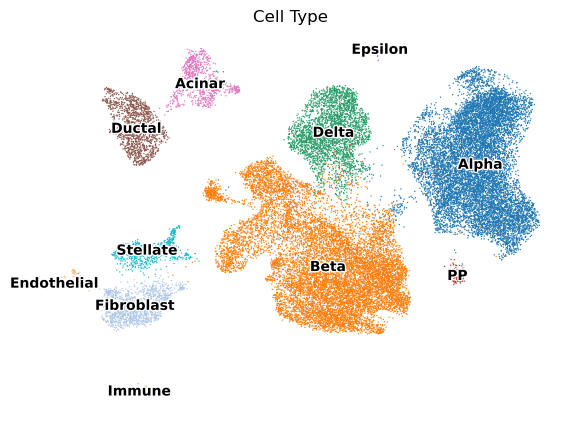

In [ ]:
sc.pl.scatter(adata, basis='umap', color='Cell_Type', legend_loc='on data',
           frameon=False, legend_fontsize=10, legend_fontoutline=2)

#### Key Insights and Shortcomings
My pipeline successfully clustered cells into distinct groups corresponding to known cell types, highlighting the algorithm's ability to discern subtle biological differences such as the heterogeneity within Beta cells and rare cell types in the dataset like Epsilon cells. However, variations in cluster counts across different subsets indicated a sensitivity to the dataset's size or composition, suggesting a need for a large dataset to ensure comprehensive coverage of all cell types and subtypes.

#### Improvements and Future Work
The integration of additional biological context and validation with external datasets could further enhance the robustness and interpretability of the clustering results. I also plan to explore neural network clustering methods as well as a graph neural network-based framework for single-cell active pathways and gene modules analysis as a follow-up of my analysis during the break.

#### Conclusion
Throughout this paper, I demonstrated a successful application of a fine-tuned clustering analysis that has not only elucidated the heterogeneity and identified rare populations within the scRNA-seq dataset but also laid a strong foundation for further exploration of cellular characteristics and functions. The results affirm the utility of integrating computational clustering methods with domain-specific knowledge to uncover the complexity of biological systems.

AI Statement:
I used AI to ask questions to deepen my understanding of the class materials and the concepts I am using in this paper. I also used it to review my writing to ensure clarity. However, I ensured the authenticity of all parts of this paper.

<a id='10'></a>
# 10. References

Da Silva Xavier, G. (2018). The cells of the islets of Langerhans. Journal of Clinical Medicine, 7(3), 54. https://doi.org/10.3390/jcm7030054 

Dorrell, C., Schug, J., Canaday, P. S., Russ, H. A., Tarlow, B. D., Grompe, M. T., Horton, T., Hebrok, M., Streeter, P. R., Kaestner, K. H., & Grompe, M. (2016). Human islets contain four distinct subtypes of β cells. Nature Communications, 7(1). https://doi.org/10.1038/ncomms11756 

Scanpy. (2017). Tutorials. Scanpy 0.1.0.dev documentation. https://scanpy.readthedocs.io/en/stable/tutorials.html#integrating-datasets 

Traag, V. A., Waltman, L., & van Eck, N. J. (2019). From Louvain to Leiden: Guaranteeing well-connected communities. Scientific Reports, 9(1). https://doi.org/10.1038/s41598-019-41695-z 

Tritschler, S., Thomas, M., Böttcher, A., Ludwig, B., Schmid, J., Schubert, U., Kemter, E., Wolf, E., Lickert, H., & Theis, F. J. (2022). A transcriptional cross species map of pancreatic islet cells. Molecular Metabolism, 66, 101595. https://doi.org/10.1016/j.molmet.2022.101595

Wikimedia Foundation. (2023, September 10). Louvain method. Wikipedia. https://en.wikipedia.org/wiki/Louvain_method 

Zhang, Y., Parmigiani, G., & Johnson, W. E. (2020). Combat-seq: Batch effect adjustment for RNA-seq count data. NAR Genomics and Bioinformatics, 2(3). https://doi.org/10.1093/nargab/lqaa078 